!DEBIAN_FRONTEND=noninteractive apt-get --assume-yes install cuda-11-8

In [1]:
#!pip uninstall -y tensorflow keras
#!pip install tensorflow==2.15.0 keras==2.15.0

!pip install tf-keras

In [2]:
import os
import time
import random

from glob import glob
from PIL import Image
from IPython import display
from matplotlib import pyplot as plt

import tf_keras as keras
import os
os.environ["TF_USE_LEGACY_KERAS"] = "1"
import tensorflow.compat.v1 as tf
tf.disable_v2_behavior()

import numpy as np

In [3]:
import shutil
if os.path.exists('/kaggle/working/Model'):
    shutil.rmtree('/kaggle/working/Model')

In [4]:
print(tf.config.list_physical_devices('GPU'))
print(tf.test.gpu_device_name())

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]
/device:GPU:0


In [5]:
decom = 1
batch_size = 32
patch_size = 48
epoch = 50
eval_every_epoch = 1
start_lr = 0.0009

dataset_path = '/kaggle/input/lol-dataset/lol_dataset'
ckpt_path = '/kaggle/working/Model/Model_Data/ckpt'
test_path = f'{dataset_path}/eval15'
save_test_path = '/kaggle/working/Model/Model_Data/save'

### Utils

In [6]:
def load_images(file):
    im = Image.open(file)
    return np.array(im, dtype="float32") / 255.0

In [7]:
def save_images(filepath, result_1):
    result = np.squeeze(result_1)

    im = Image.fromarray(np.clip(result * 255.0, 0, 255.0).astype('uint8'))
    im.save(filepath, format='png')
    print(f'[*] Saved at {filepath}')

### Model Building

In [8]:
def DecomNet(input_im, layer_num, channel=64, kernel_size=3):
    input_max = tf.reduce_max(input_im, axis=3, keepdims=True)
    input_im = concat([input_max, input_im])
    with tf.variable_scope('DecomNet', reuse=tf.AUTO_REUSE):
        conv = tf.layers.conv2d(input_im, channel, kernel_size * 3, padding='same', activation=None, name="shallow_feature_extraction")
        for idx in range(layer_num):
            conv = tf.layers.conv2d(conv, channel, kernel_size, padding='same', activation=tf.nn.relu, name=f'activated_layer_{idx}')
        conv = tf.layers.conv2d(conv, 4, kernel_size, padding='same', activation=None, name='recon_layer')

    R = tf.sigmoid(conv[:,:,:,0:3])
    L = tf.sigmoid(conv[:,:,:,3:4])

    return R, L

def RelightNet(input_L, input_R, channel=64, kernel_size=3):
    input_im = concat([input_R, input_L])
    with tf.variable_scope('RelightNet', reuse=tf.AUTO_REUSE):
        conv0 = tf.layers.conv2d(input_im, channel, kernel_size, padding='same', activation=None)
        conv1 = tf.layers.conv2d(conv0, channel, kernel_size, strides=2, padding='same', activation=tf.nn.relu)
        conv2 = tf.layers.conv2d(conv1, channel, kernel_size, strides=2, padding='same', activation=tf.nn.relu)
        conv3 = tf.layers.conv2d(conv2, channel, kernel_size, strides=2, padding='same', activation=tf.nn.relu)
        
        up1 = tf.image.resize_nearest_neighbor(conv3, (tf.shape(conv2)[1], tf.shape(conv2)[2]))
        deconv1 = tf.layers.conv2d(up1, channel, kernel_size, padding='same', activation=tf.nn.relu) + conv2
        up2 = tf.image.resize_nearest_neighbor(deconv1, (tf.shape(conv1)[1], tf.shape(conv1)[2]))
        deconv2= tf.layers.conv2d(up2, channel, kernel_size, padding='same', activation=tf.nn.relu) + conv1
        up3 = tf.image.resize_nearest_neighbor(deconv2, (tf.shape(conv0)[1], tf.shape(conv0)[2]))
        deconv3 = tf.layers.conv2d(up3, channel, kernel_size, padding='same', activation=tf.nn.relu) + conv0
        
        deconv1_resize = tf.image.resize_nearest_neighbor(deconv1, (tf.shape(deconv3)[1], tf.shape(deconv3)[2]))
        deconv2_resize = tf.image.resize_nearest_neighbor(deconv2, (tf.shape(deconv3)[1], tf.shape(deconv3)[2]))
        feature_gather = concat([deconv1_resize, deconv2_resize, deconv3])
        feature_fusion = tf.layers.conv2d(feature_gather, channel, 1, padding='same', activation=None)
        output = tf.layers.conv2d(feature_fusion, 1, 3, padding='same', activation=None)
    return output

In [9]:
def concat(layers):
    return tf.concat(layers, axis=3)

In [10]:
def data_augmentation(image, mode):
    match mode:
        case 0:
            return image
        case 1:
            return np.flipud(image)
        case 2:
            return np.rot90(image)
        case 3:
            image = np.rot90(image)
            return np.flipud(image)
        case 4:
            return np.rot90(image, k=2)
        case 5:
            image = np.rot90(image, k=2)
            return np.flipud(image)
        case 6:
            return np.rot90(image, k=3)
        case 7:
            image = np.rot90(image, k=3)
            return np.flipud(image)

In [11]:
class lowlight_enhance:
    def __init__(self, sess):
        self.sess = sess
        self.DecomNet_layer_num = 5

        self.input_low = tf.placeholder(tf.float32, [None, None, None, 3], name='input_low')
        self.input_high = tf.placeholder(tf.float32, [None, None, None, 3], name='input_high')

        [R_low, I_low] = DecomNet(self.input_low, layer_num=self.DecomNet_layer_num)
        [R_high, I_high] = DecomNet(self.input_high, layer_num=self.DecomNet_layer_num)
        
        I_delta = RelightNet(I_low, R_low)

        I_low_3 = concat([I_low, I_low, I_low])
        I_high_3 = concat([I_high, I_high, I_high])
        I_delta_3 = concat([I_delta, I_delta, I_delta])

        self.output_R_low = R_low
        self.output_I_low = I_low_3
        self.output_I_delta = I_delta_3
        self.output_S = R_low * I_delta_3

        self.recon_loss_low = tf.reduce_mean(tf.abs(R_low * I_low_3 -  self.input_low))
        self.recon_loss_high = tf.reduce_mean(tf.abs(R_high * I_high_3 - self.input_high))
        self.recon_loss_mutal_low = tf.reduce_mean(tf.abs(R_high * I_low_3 - self.input_low))
        self.recon_loss_mutal_high = tf.reduce_mean(tf.abs(R_low * I_high_3 - self.input_high))
        self.equal_R_loss = tf.reduce_mean(tf.abs(R_low - R_high))
        self.relight_loss = tf.reduce_mean(tf.abs(R_low * I_delta_3 - self.input_high))

        self.Ismooth_loss_low = self.smooth(I_low, R_low)
        self.Ismooth_loss_high = self.smooth(I_high, R_high)
        self.Ismooth_loss_delta = self.smooth(I_delta, R_low)

        self.loss_Decom = self.recon_loss_low + self.recon_loss_high + 0.001 * self.recon_loss_mutal_low + 0.001 * self.recon_loss_mutal_high + 0.1 * self.Ismooth_loss_low + 0.1 * self.Ismooth_loss_high + 0.01 * self.equal_R_loss
        self.loss_Relight = self.relight_loss + 3 * self.Ismooth_loss_delta

        self.lr = tf.placeholder(tf.float32, name='learning_rate')
        optimizer = tf.train.AdamOptimizer(self.lr, name='AdamOptimizer')

        self.var_Decom = [var for var in tf.trainable_variables() if 'DecomNet' in var.name]
        self.var_Relight = [var for var in tf.trainable_variables() if 'RelightNet' in var.name]

        self.train_op_Decom = optimizer.minimize(self.loss_Decom, var_list = self.var_Decom)
        self.train_op_Relight = optimizer.minimize(self.loss_Relight, var_list = self.var_Relight)

        self.sess.run(tf.global_variables_initializer())

        self.saver_Decom = tf.train.Saver(var_list = self.var_Decom)
        self.saver_Relight = tf.train.Saver(var_list = self.var_Relight)

        print("[*] Initialize model successfully...")

    def gradient(self, input_tensor, direction):
        self.smooth_kernel_x = tf.reshape(tf.constant([[0, 0], [-1, 1]], tf.float32), [2, 2, 1, 1])
        self.smooth_kernel_y = tf.transpose(self.smooth_kernel_x, [1, 0, 2, 3])

        if direction == "x":
            kernel = self.smooth_kernel_x
        elif direction == "y":
            kernel = self.smooth_kernel_y
        return tf.abs(tf.nn.conv2d(input_tensor, kernel, strides=[1, 1, 1, 1], padding='SAME'))

    def ave_gradient(self, input_tensor, direction):
        return tf.layers.average_pooling2d(self.gradient(input_tensor, direction), pool_size=3, strides=1, padding='SAME')

    def smooth(self, input_I, input_R):
        input_R = tf.image.rgb_to_grayscale(input_R)
        return tf.reduce_mean(self.gradient(input_I, "x") * tf.exp(-10 * self.ave_gradient(input_R, "x")) + self.gradient(input_I, "y") * tf.exp(-10 * self.ave_gradient(input_R, "y")))

    def evaluate_generate_image(self, epoch_num, eval_low_data, eval_high_data, train_phase, result_1, result_2, values):
        result_1 = np.squeeze(result_1)
        result_2 = np.squeeze(result_2)
        
        result_com = np.clip(result_1 * result_2, 0, 1)
        
        result_1 = np.clip(result_1, 0.0, 1.0)
        result_2 = np.clip(result_2, 0.0, 1.0)
        
        plt.figure(figsize=(15, 15))
        display_list = [eval_low_data, eval_high_data, result_1, result_2, result_com]
        title = ['Input', 'Ground Truth'] + values + ['Combined']
        
        for i in range(len(title)):
            plt.subplot(1, len(title), i+1)
            plt.title(title[i])
            plt.imshow(display_list[i])
            plt.axis('off')
        plt.show()
    
    def evaluate(self, epoch_num, eval_low_data, train_phase, eval_high_data):
        print(f"[*] Evaluating for phase {train_phase} / epoch {epoch_num}...")

        for idx in range(len(eval_low_data)):
            input_low_eval = np.expand_dims(eval_low_data[idx], axis=0)

            if train_phase == "Decom":
                result_1, result_2 = self.sess.run([self.output_R_low, self.output_I_low], feed_dict={self.input_low: input_low_eval})
                values = ['Reflectance_Low', 'Illumination_Low']
            if train_phase == "Relight":
                result_1, result_2 = self.sess.run([self.output_S, self.output_I_delta], feed_dict={self.input_low: input_low_eval})
                values = ['Sample', 'Illumination_Delta']
            
            self.evaluate_generate_image(epoch_num, eval_low_data[idx], eval_high_data[idx], train_phase, result_1, result_2, values)

    def train(self, train_low_data, train_high_data, eval_low_data, batch_size, patch_size, epoch, lr, ckpt_dir, eval_every_epoch, train_phase, eval_high_data):
        assert len(train_low_data) == len(train_high_data)
        numBatch = len(train_low_data) // int(batch_size)

        if train_phase == "Decom":
            train_op = self.train_op_Decom
            train_loss = self.loss_Decom
            saver = self.saver_Decom
        elif train_phase == "Relight":
            train_op = self.train_op_Relight
            train_loss = self.loss_Relight
            saver = self.saver_Relight

        load_model_status, global_step = self.load(saver, ckpt_dir)
        if load_model_status:
            iter_num = global_step
            start_epoch = global_step // numBatch
            start_step = global_step % numBatch
            print("[*] Model restore success!")
        else:
            iter_num = 0
            start_epoch = 0
            start_step = 0
            print("[*] No pretrained model found!")

        print(f"[*] Start training for phase {train_phase}, with start epoch {start_epoch} start iter {iter_num} : ")

        start_time = time.time()
        image_id = 0

        for epoch in range(start_epoch, epoch):
            epoch_time = time.time()
            for batch_id in range(start_step, numBatch):
                batch_input_low = np.zeros((batch_size, patch_size, patch_size, 3), dtype="float32")
                batch_input_high = np.zeros((batch_size, patch_size, patch_size, 3), dtype="float32")
                for patch_id in range(batch_size):
                    h, w, _ = train_low_data[image_id].shape
                    x = random.randint(0, h - patch_size)
                    y = random.randint(0, w - patch_size)
            
                    rand_mode = random.randint(0, 7)
                    batch_input_low[patch_id, :, :, :] = data_augmentation(train_low_data[image_id][x : x+patch_size, y : y+patch_size, :], rand_mode)
                    batch_input_high[patch_id, :, :, :] = data_augmentation(train_high_data[image_id][x : x+patch_size, y : y+patch_size, :], rand_mode)
                    
                    image_id = (image_id + 1) % len(train_low_data)
                    if image_id == 0:
                        tmp = list(zip(train_low_data, train_high_data))
                        random.shuffle(list(tmp))
                        train_low_data, train_high_data  = zip(*tmp)

                _, loss = self.sess.run([train_op, train_loss], feed_dict={self.input_low: batch_input_low, 
                                                                           self.input_high: batch_input_high, 
                                                                           self.lr: lr[epoch]})

                print(f"{train_phase} Epoch: [{(epoch + 1):2d}] [{(batch_id + 1):4d}/{numBatch:4d}] time: {time.time() - epoch_time:4.4f}, loss: {loss:.6f}", end='\r')
                iter_num += 1
            print()
            if (epoch + 1) % eval_every_epoch == 0:
                self.evaluate(epoch + 1, eval_low_data, train_phase, eval_high_data)
                self.save(saver, iter_num, ckpt_dir, f"RetinexNet-{train_phase}")

        print(f"[*] Finish training for phase {train_phase} in time {time.time() - start_time:4.4f}.")

    def save(self, saver, iter_num, ckpt_dir, model_name):
        if not os.path.exists(ckpt_dir):
            os.makedirs(ckpt_dir)
        print(f"[*] Saving model {model_name}")
        saver.save(self.sess, os.path.join(ckpt_dir, model_name), global_step=iter_num)

    def load(self, saver, ckpt_dir):
        ckpt = tf.train.get_checkpoint_state(ckpt_dir)
        if ckpt and ckpt.model_checkpoint_path:
            full_path = tf.train.latest_checkpoint(ckpt_dir)
            try:
                global_step = int(full_path.split('/')[-1].split('-')[-1])
            except ValueError:
                global_step = None
            saver.restore(self.sess, full_path)
            return True, global_step
        else:
            print(f"[*] Failed to load model from {ckpt_dir}")
            return False, 0

    def test(self, test_low_data, test_high_data, test_low_data_names, save_dir, decom_flag):
        tf.global_variables_initializer().run()

        print("[*] Reading checkpoint...")
        load_model_status_Decom, _ = self.load(self.saver_Decom, ckpt_path + '/Decom')
        load_model_status_Relight, _ = self.load(self.saver_Relight, ckpt_path + '/Relight')
        if load_model_status_Decom and load_model_status_Relight:
            print("[*] Load weights successfully...")
        
        print("[*] Testing...")
        for idx in range(len(test_low_data)):
            print(test_low_data_names[idx])
            [_, name] = os.path.split(test_low_data_names[idx])
            suffix = name[name.find('.') + 1:]
            name = name[:name.find('.')]

            input_low_test = np.expand_dims(test_low_data[idx], axis=0)
            [R_low, I_low, I_delta, S] = self.sess.run([self.output_R_low, self.output_I_low, self.output_I_delta, self.output_S], feed_dict = {self.input_low: input_low_test})

            if decom_flag == 1:
                save_images(os.path.join(save_dir, name + "_R_low." + suffix), R_low)
                save_images(os.path.join(save_dir, name + "_I_low." + suffix), I_low)
                save_images(os.path.join(save_dir, name + "_I_delta." + suffix), I_delta)
            save_images(os.path.join(save_dir, name + "_S."   + suffix), S)
            save_images(os.path.join(save_dir, name + "_Result." + suffix), [np.squeeze(S) * np.squeeze(I_delta)])
            
            plt.figure(figsize=(15, 15))
            title = ['Input', 'Ground Truth', 'Sample', 'Illumination', 'Result']
            display_list = [test_low_data[idx], test_high_data[idx], np.squeeze(S), np.squeeze(I_delta), np.clip(np.squeeze(S) * np.squeeze(I_delta), 0, 1)]
            
            for i in range(len(title)):
                plt.subplot(1, len(title), i+1)
                plt.title(title[i])
                plt.imshow(display_list[i])
                plt.axis('off')
            plt.show()

### Model Training

In [12]:
def lowlight_train(lowlight_enhance):
    if not os.path.exists(ckpt_path):
        os.makedirs(ckpt_path)

    lr = start_lr * np.ones([epoch])
    lr[20:] = lr[0] / 10.0

    train_low_data = []
    train_high_data = []

    train_low_data_names = glob(f'{dataset_path}/our485/low/*.png')
    train_low_data_names.sort()
    train_high_data_names = glob(f'{dataset_path}/our485/high/*.png')
    train_high_data_names.sort()
    
    assert len(train_low_data_names) == len(train_high_data_names)
    
    print(f'[*] Number of training data: {len(train_low_data_names)}')

    for idx in range(len(train_low_data_names)):
        low_im = load_images(train_low_data_names[idx])
        train_low_data.append(low_im)
        high_im = load_images(train_high_data_names[idx])
        train_high_data.append(high_im)

    eval_low_data = []
    eval_high_data = []

    eval_low_data_name = glob(f'{dataset_path}/eval15/low/*.*')

    for idx in range(len(eval_low_data_name)):
        eval_low_im = load_images(eval_low_data_name[idx])
        eval_low_data.append(eval_low_im)
        break
        
    eval_high_data_name = glob(f'{dataset_path}/eval15/high/*.*')

    for idx in range(len(eval_high_data_name)):
        eval_high_im = load_images(eval_high_data_name[idx])
        eval_high_data.append(eval_high_im)
        break

    lowlight_enhance.train(train_low_data, train_high_data, eval_low_data, batch_size=batch_size, patch_size=patch_size, epoch=epoch, lr=lr, ckpt_dir=os.path.join(ckpt_path, 'Decom'), eval_every_epoch=eval_every_epoch, train_phase="Decom", eval_high_data=eval_high_data)
    lowlight_enhance.train(train_low_data, train_high_data, eval_low_data, batch_size=batch_size, patch_size=patch_size, epoch=epoch, lr=lr, ckpt_dir=os.path.join(ckpt_path, 'Relight'), eval_every_epoch=eval_every_epoch, train_phase="Relight", eval_high_data=eval_high_data)

/tmp/ipykernel_36/1021350135.py:5: UserWarning: `tf.layers.conv2d` is deprecated and will be removed in a future version. Please Use `tf.keras.layers.Conv2D` instead.
  conv = tf.layers.conv2d(input_im, channel, kernel_size * 3, padding='same', activation=None, name="shallow_feature_extraction")
/tmp/ipykernel_36/1021350135.py:7: UserWarning: `tf.layers.conv2d` is deprecated and will be removed in a future version. Please Use `tf.keras.layers.Conv2D` instead.
  conv = tf.layers.conv2d(conv, channel, kernel_size, padding='same', activation=tf.nn.relu, name=f'activated_layer_{idx}')
/tmp/ipykernel_36/1021350135.py:8: UserWarning: `tf.layers.conv2d` is deprecated and will be removed in a future version. Please Use `tf.keras.layers.Conv2D` instead.
  conv = tf.layers.conv2d(conv, 4, kernel_size, padding='same', activation=None, name='recon_layer')
/tmp/ipykernel_36/1021350135.py:18: UserWarning: `tf.layers.conv2d` is deprecated and will be removed in a future version. Please Use `tf.keras.

[*] Initialize model successfully...
[*] Number of training data: 485
[*] Failed to load model from /kaggle/working/Model/Model_Data/ckpt/Decom
[*] No pretrained model found!
[*] Start training for phase Decom, with start epoch 0 start iter 0 : 
Decom Epoch: [ 1] [  15/  15] time: 3.0642, loss: 0.325087
[*] Evaluating for phase Decom / epoch 1...


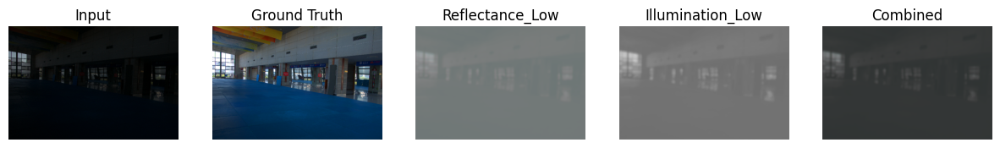

[*] Saving model RetinexNet-Decom
Decom Epoch: [ 2] [  15/  15] time: 0.4873, loss: 0.155648
[*] Evaluating for phase Decom / epoch 2...


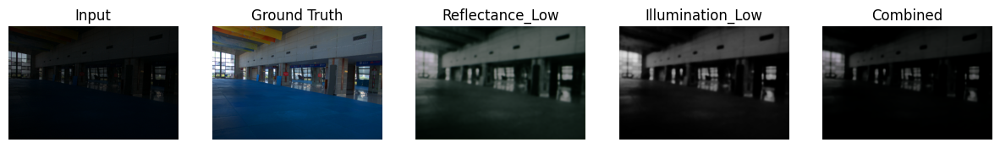

[*] Saving model RetinexNet-Decom
Decom Epoch: [ 3] [  15/  15] time: 0.4863, loss: 0.123026
[*] Evaluating for phase Decom / epoch 3...


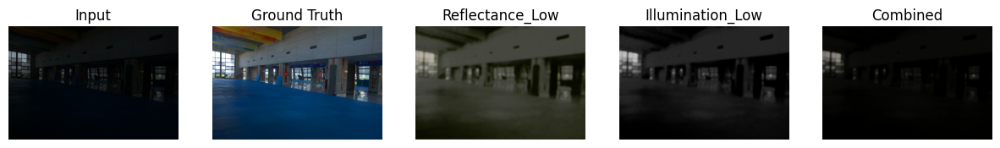

[*] Saving model RetinexNet-Decom
Decom Epoch: [ 4] [  15/  15] time: 0.4869, loss: 0.092526
[*] Evaluating for phase Decom / epoch 4...


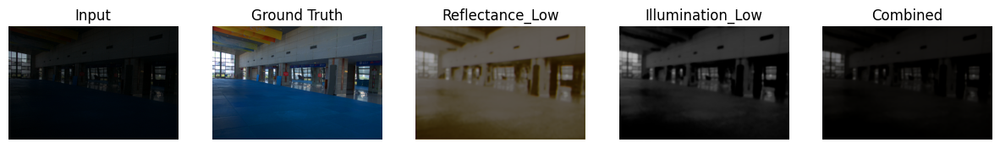

[*] Saving model RetinexNet-Decom
Decom Epoch: [ 5] [  15/  15] time: 0.4942, loss: 0.089124
[*] Evaluating for phase Decom / epoch 5...


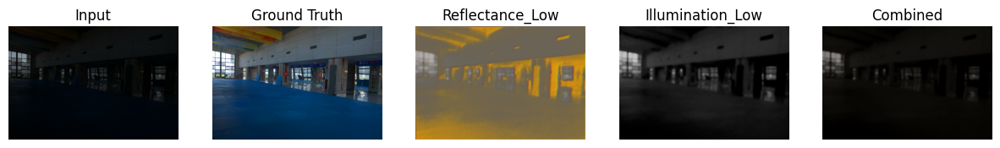

[*] Saving model RetinexNet-Decom
Decom Epoch: [ 6] [  15/  15] time: 0.4919, loss: 0.083959
[*] Evaluating for phase Decom / epoch 6...


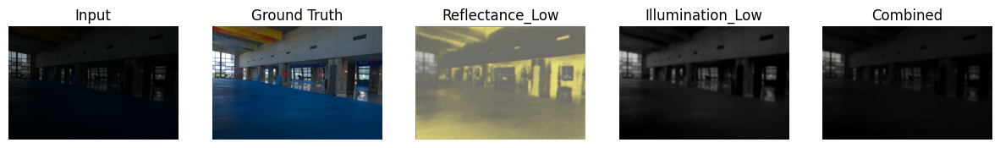

[*] Saving model RetinexNet-Decom
Decom Epoch: [ 7] [  15/  15] time: 0.4884, loss: 0.067945
[*] Evaluating for phase Decom / epoch 7...


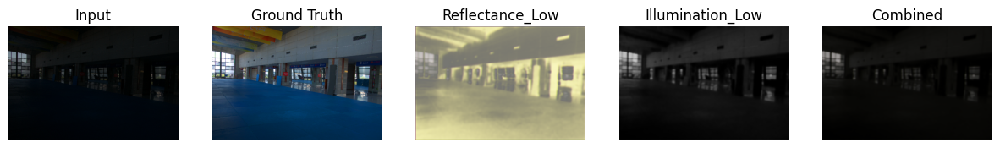

[*] Saving model RetinexNet-Decom
Decom Epoch: [ 8] [  15/  15] time: 0.4863, loss: 0.067324
[*] Evaluating for phase Decom / epoch 8...


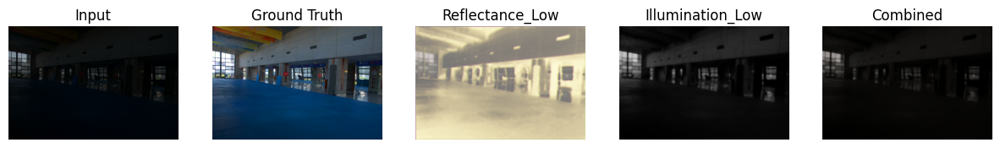

[*] Saving model RetinexNet-Decom
Decom Epoch: [ 9] [  15/  15] time: 0.4871, loss: 0.076826
[*] Evaluating for phase Decom / epoch 9...


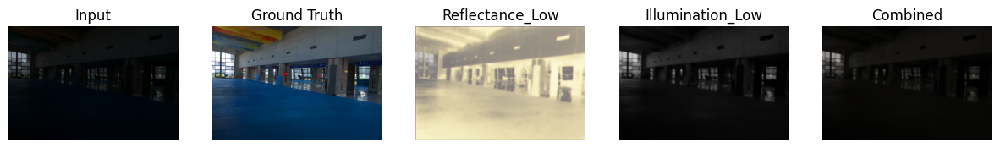

[*] Saving model RetinexNet-Decom
Decom Epoch: [10] [  15/  15] time: 0.4872, loss: 0.059708
[*] Evaluating for phase Decom / epoch 10...


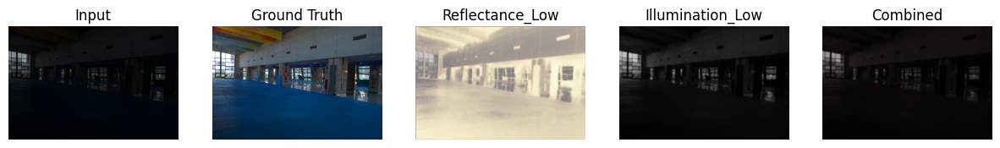

[*] Saving model RetinexNet-Decom
Decom Epoch: [11] [  15/  15] time: 0.4873, loss: 0.063565
[*] Evaluating for phase Decom / epoch 11...


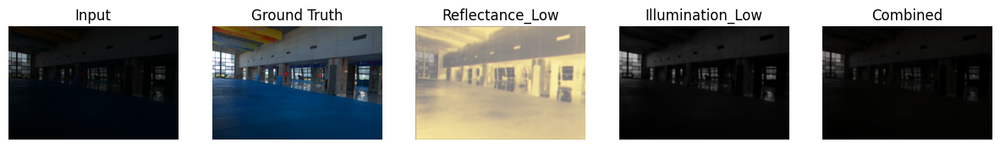

[*] Saving model RetinexNet-Decom
Decom Epoch: [12] [  15/  15] time: 0.4891, loss: 0.062022
[*] Evaluating for phase Decom / epoch 12...


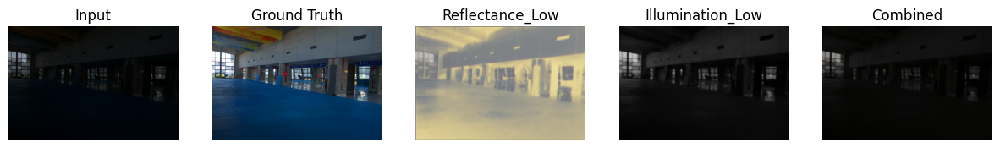

[*] Saving model RetinexNet-Decom
Decom Epoch: [13] [  15/  15] time: 0.4895, loss: 0.053271
[*] Evaluating for phase Decom / epoch 13...


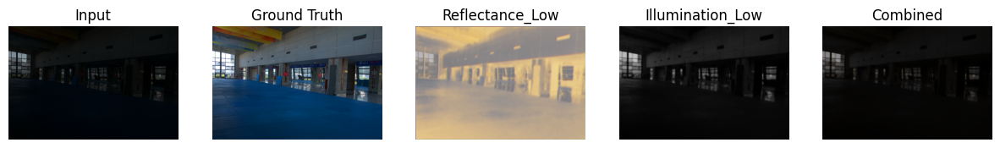

[*] Saving model RetinexNet-Decom
Decom Epoch: [14] [  15/  15] time: 0.4901, loss: 0.057008
[*] Evaluating for phase Decom / epoch 14...


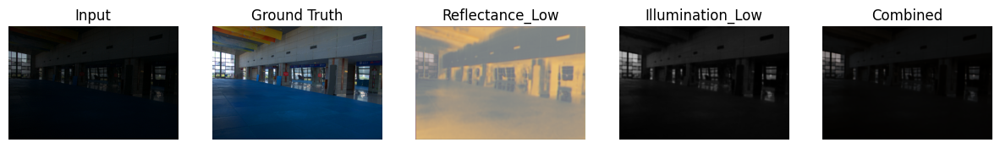

[*] Saving model RetinexNet-Decom
Decom Epoch: [15] [  15/  15] time: 0.4906, loss: 0.063383
[*] Evaluating for phase Decom / epoch 15...


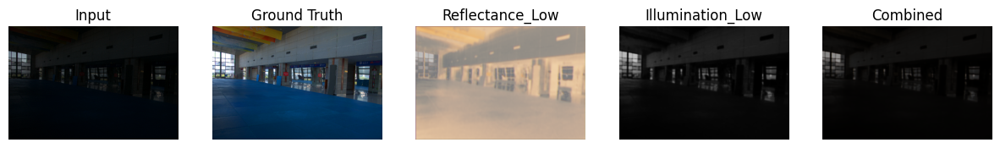

[*] Saving model RetinexNet-Decom
Decom Epoch: [16] [  15/  15] time: 0.4853, loss: 0.051071
[*] Evaluating for phase Decom / epoch 16...


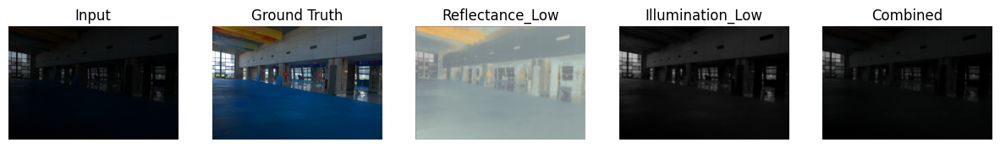

[*] Saving model RetinexNet-Decom
Decom Epoch: [17] [  15/  15] time: 0.4892, loss: 0.065304
[*] Evaluating for phase Decom / epoch 17...


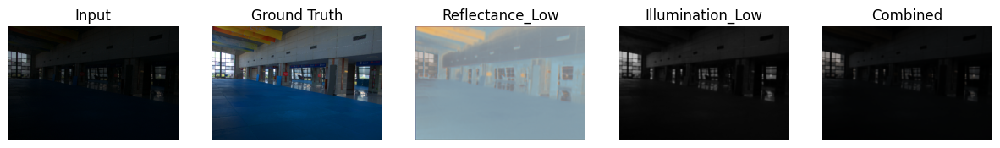

[*] Saving model RetinexNet-Decom
Decom Epoch: [18] [  15/  15] time: 0.4879, loss: 0.060248
[*] Evaluating for phase Decom / epoch 18...


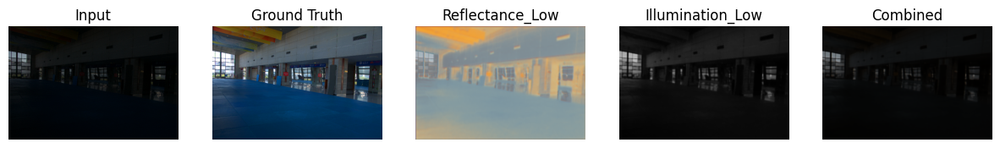

[*] Saving model RetinexNet-Decom
Decom Epoch: [19] [  15/  15] time: 0.4910, loss: 0.059415
[*] Evaluating for phase Decom / epoch 19...


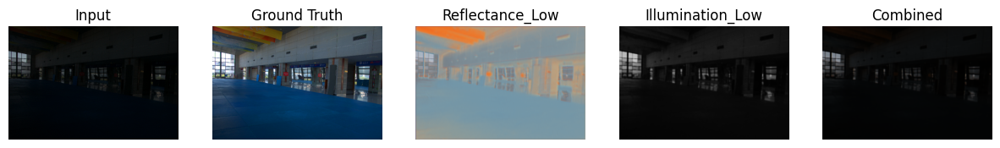

[*] Saving model RetinexNet-Decom
Decom Epoch: [20] [  15/  15] time: 0.4856, loss: 0.073325
[*] Evaluating for phase Decom / epoch 20...


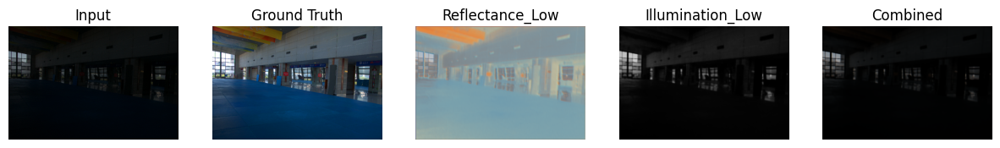

[*] Saving model RetinexNet-Decom
Decom Epoch: [21] [  15/  15] time: 0.4887, loss: 0.051869
[*] Evaluating for phase Decom / epoch 21...


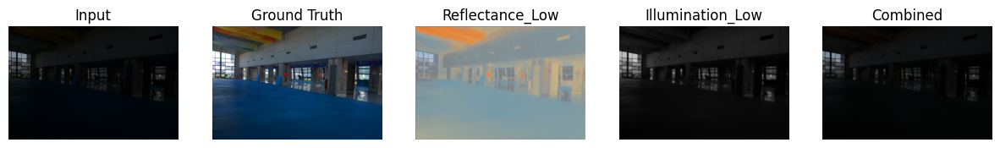

[*] Saving model RetinexNet-Decom
Decom Epoch: [22] [  15/  15] time: 0.4906, loss: 0.048253
[*] Evaluating for phase Decom / epoch 22...


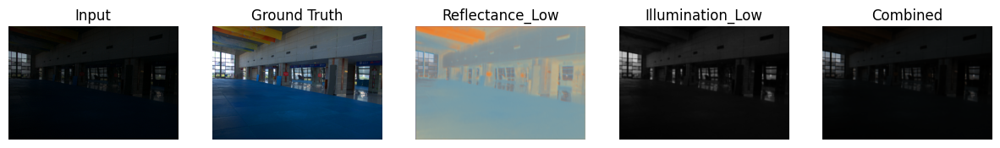

[*] Saving model RetinexNet-Decom
Decom Epoch: [23] [  15/  15] time: 0.4894, loss: 0.050090
[*] Evaluating for phase Decom / epoch 23...


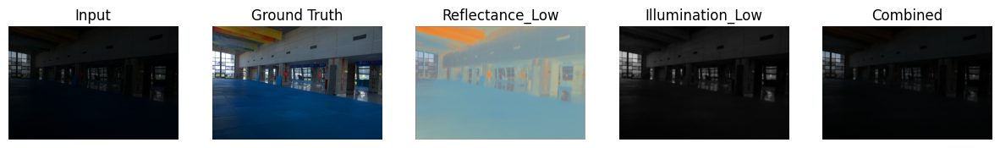

[*] Saving model RetinexNet-Decom
Decom Epoch: [24] [  15/  15] time: 0.4976, loss: 0.049821
[*] Evaluating for phase Decom / epoch 24...


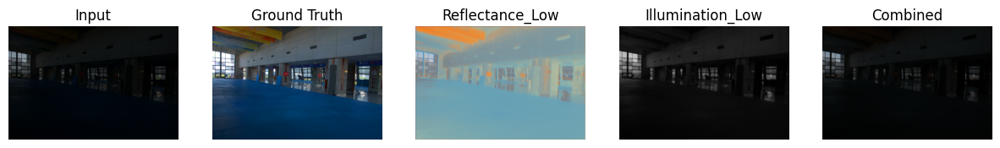

[*] Saving model RetinexNet-Decom
Decom Epoch: [25] [  15/  15] time: 0.4955, loss: 0.052729
[*] Evaluating for phase Decom / epoch 25...


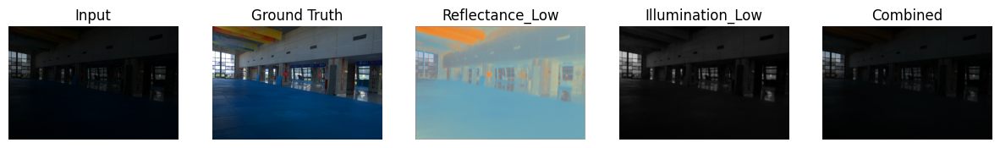

[*] Saving model RetinexNet-Decom
Decom Epoch: [26] [  15/  15] time: 0.4907, loss: 0.045687
[*] Evaluating for phase Decom / epoch 26...


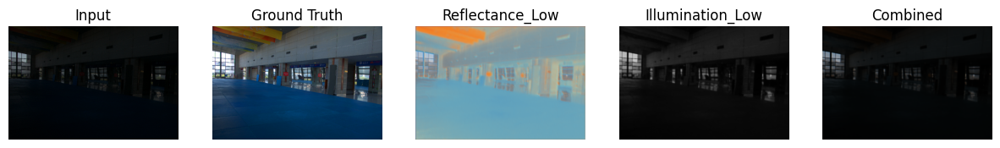

[*] Saving model RetinexNet-Decom
Decom Epoch: [27] [  15/  15] time: 0.4880, loss: 0.040988
[*] Evaluating for phase Decom / epoch 27...


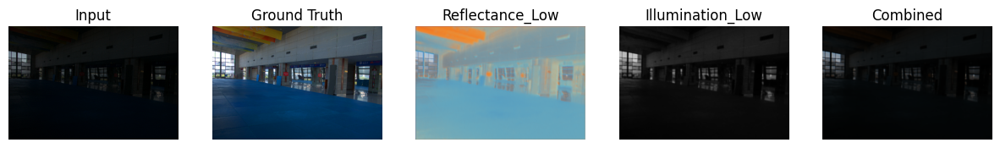

[*] Saving model RetinexNet-Decom
Decom Epoch: [28] [  15/  15] time: 0.4902, loss: 0.041210
[*] Evaluating for phase Decom / epoch 28...


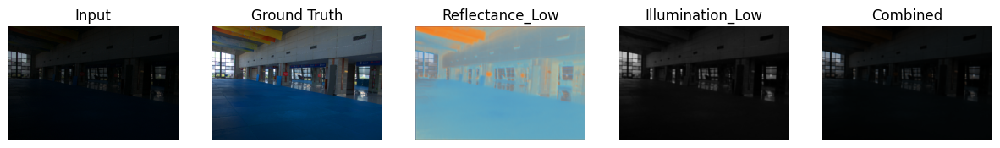

[*] Saving model RetinexNet-Decom
Decom Epoch: [29] [  15/  15] time: 0.4898, loss: 0.038494
[*] Evaluating for phase Decom / epoch 29...


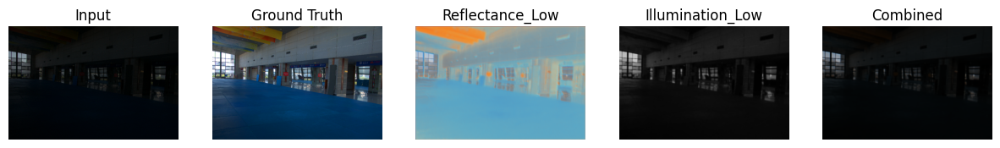

[*] Saving model RetinexNet-Decom
Decom Epoch: [30] [  15/  15] time: 0.4877, loss: 0.036018
[*] Evaluating for phase Decom / epoch 30...


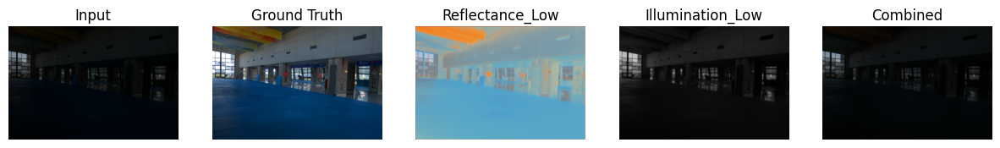

[*] Saving model RetinexNet-Decom
Decom Epoch: [31] [  15/  15] time: 0.4865, loss: 0.034593
[*] Evaluating for phase Decom / epoch 31...


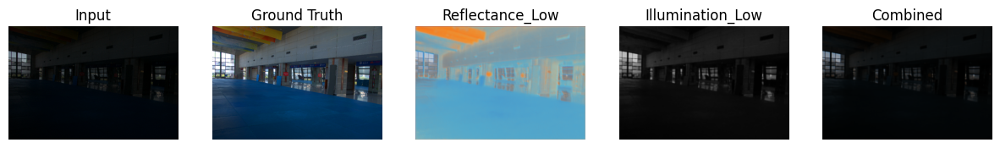

[*] Saving model RetinexNet-Decom
Decom Epoch: [32] [  15/  15] time: 0.4892, loss: 0.036161
[*] Evaluating for phase Decom / epoch 32...


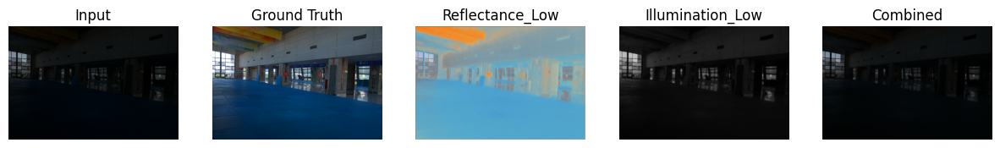

[*] Saving model RetinexNet-Decom
Decom Epoch: [33] [  15/  15] time: 0.4873, loss: 0.038222
[*] Evaluating for phase Decom / epoch 33...


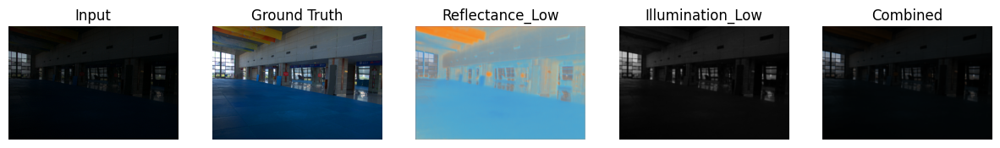

[*] Saving model RetinexNet-Decom
Decom Epoch: [34] [  15/  15] time: 0.4882, loss: 0.033334
[*] Evaluating for phase Decom / epoch 34...


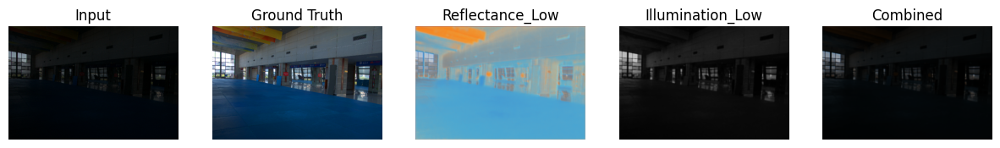

[*] Saving model RetinexNet-Decom
Decom Epoch: [35] [  15/  15] time: 0.4870, loss: 0.035986
[*] Evaluating for phase Decom / epoch 35...


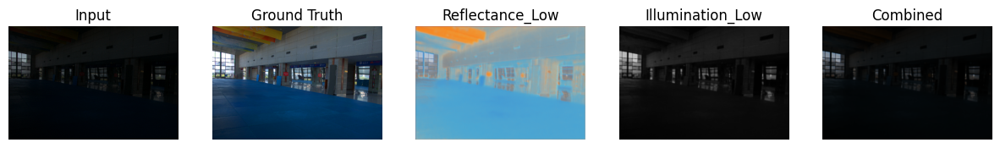

[*] Saving model RetinexNet-Decom
Decom Epoch: [36] [  15/  15] time: 0.4861, loss: 0.035885
[*] Evaluating for phase Decom / epoch 36...


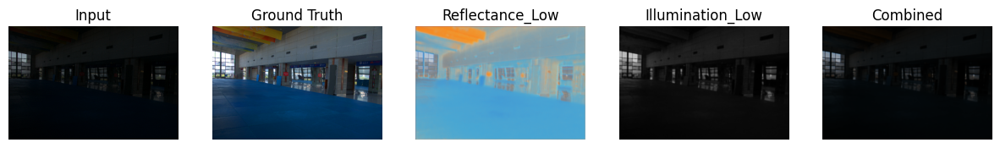

[*] Saving model RetinexNet-Decom
Decom Epoch: [37] [  15/  15] time: 0.4873, loss: 0.036943
[*] Evaluating for phase Decom / epoch 37...


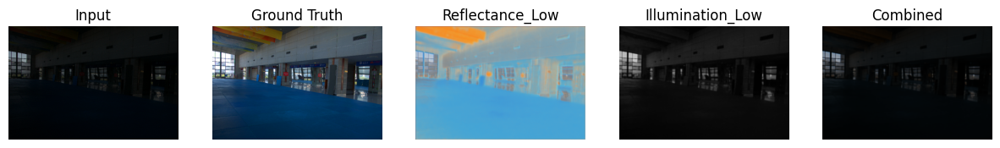

[*] Saving model RetinexNet-Decom
Decom Epoch: [38] [  15/  15] time: 0.4879, loss: 0.027421
[*] Evaluating for phase Decom / epoch 38...


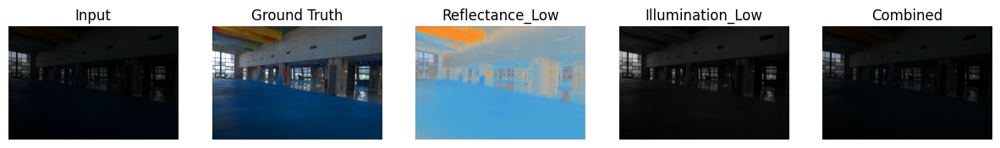

[*] Saving model RetinexNet-Decom
Decom Epoch: [39] [  15/  15] time: 0.4859, loss: 0.035620
[*] Evaluating for phase Decom / epoch 39...


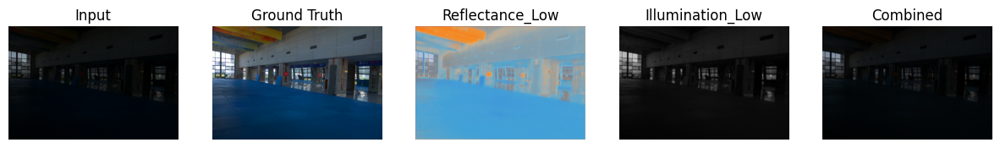

[*] Saving model RetinexNet-Decom
Decom Epoch: [40] [  15/  15] time: 0.4951, loss: 0.043475
[*] Evaluating for phase Decom / epoch 40...


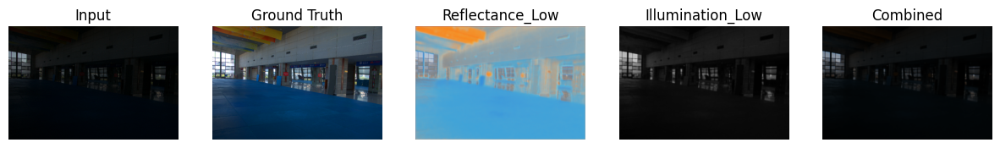

[*] Saving model RetinexNet-Decom
Decom Epoch: [41] [  15/  15] time: 0.7881, loss: 0.039169
[*] Evaluating for phase Decom / epoch 41...


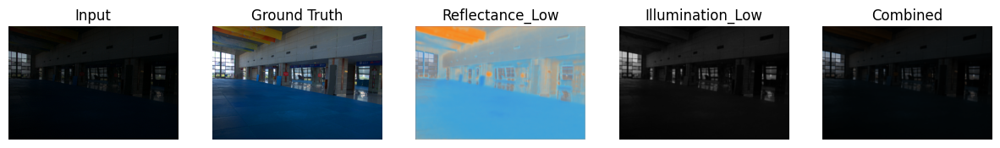

[*] Saving model RetinexNet-Decom
Decom Epoch: [42] [  15/  15] time: 0.4925, loss: 0.040366
[*] Evaluating for phase Decom / epoch 42...


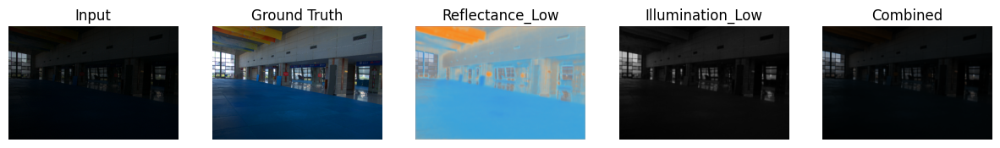

[*] Saving model RetinexNet-Decom
Decom Epoch: [43] [  15/  15] time: 0.4887, loss: 0.041523
[*] Evaluating for phase Decom / epoch 43...


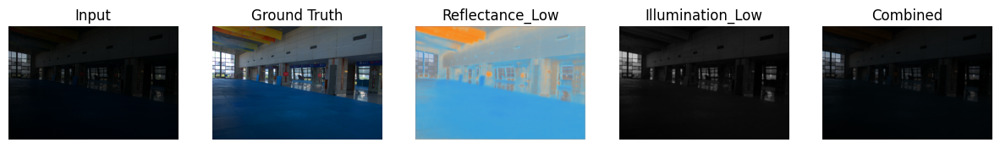

[*] Saving model RetinexNet-Decom
Decom Epoch: [44] [  15/  15] time: 0.4894, loss: 0.040189
[*] Evaluating for phase Decom / epoch 44...


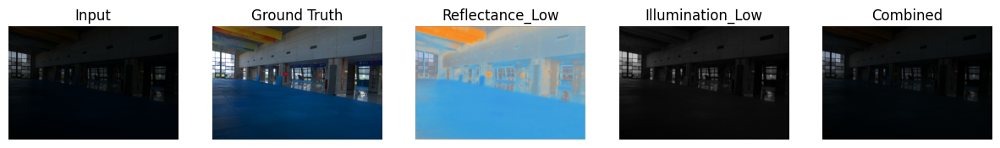

[*] Saving model RetinexNet-Decom
Decom Epoch: [45] [  15/  15] time: 0.4883, loss: 0.039326
[*] Evaluating for phase Decom / epoch 45...


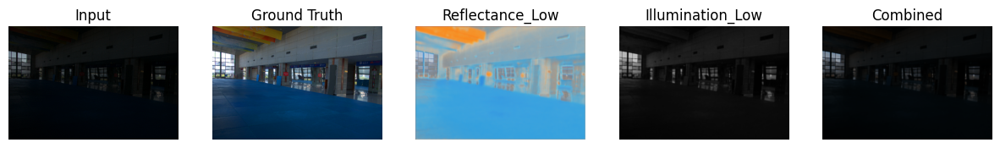

[*] Saving model RetinexNet-Decom
Decom Epoch: [46] [  15/  15] time: 0.4901, loss: 0.034074
[*] Evaluating for phase Decom / epoch 46...


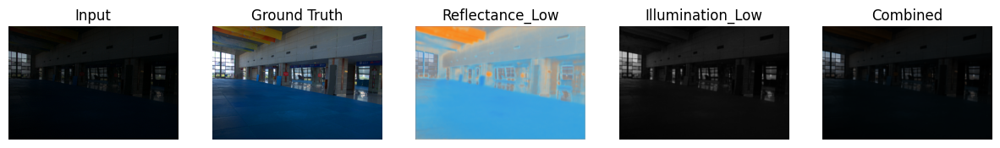

[*] Saving model RetinexNet-Decom
Decom Epoch: [47] [  15/  15] time: 0.4839, loss: 0.041069
[*] Evaluating for phase Decom / epoch 47...


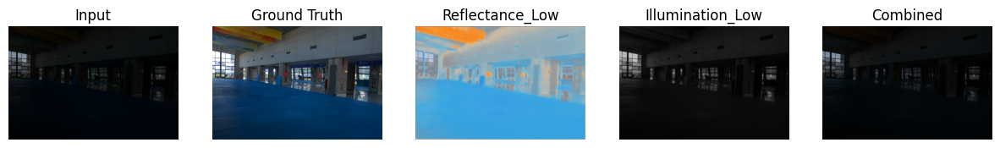

[*] Saving model RetinexNet-Decom
Decom Epoch: [48] [  15/  15] time: 0.4903, loss: 0.036640
[*] Evaluating for phase Decom / epoch 48...


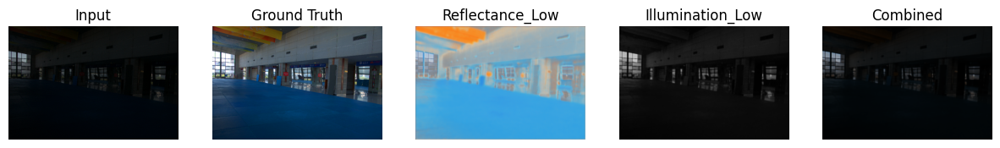

[*] Saving model RetinexNet-Decom
Decom Epoch: [49] [  15/  15] time: 0.4882, loss: 0.043105
[*] Evaluating for phase Decom / epoch 49...


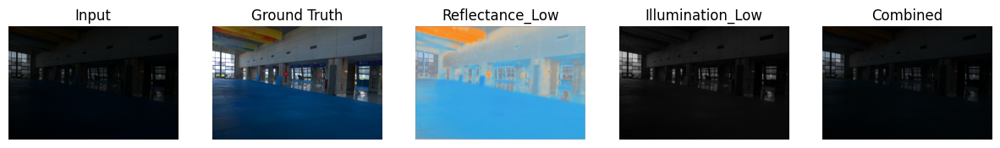

[*] Saving model RetinexNet-Decom
Decom Epoch: [50] [  15/  15] time: 0.5043, loss: 0.041788
[*] Evaluating for phase Decom / epoch 50...


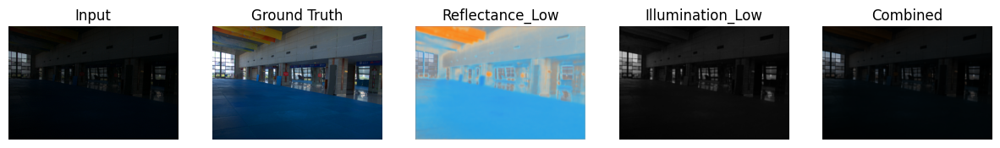

[*] Saving model RetinexNet-Decom
[*] Finish training for phase Decom in time 62.0792.
[*] Failed to load model from /kaggle/working/Model/Model_Data/ckpt/Relight
[*] No pretrained model found!
[*] Start training for phase Relight, with start epoch 0 start iter 0 : 
Relight Epoch: [ 1] [  15/  15] time: 0.9657, loss: 0.184184
[*] Evaluating for phase Relight / epoch 1...


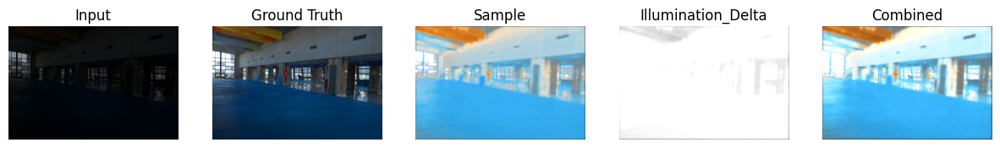

[*] Saving model RetinexNet-Relight
Relight Epoch: [ 2] [  15/  15] time: 0.3133, loss: 0.174112
[*] Evaluating for phase Relight / epoch 2...


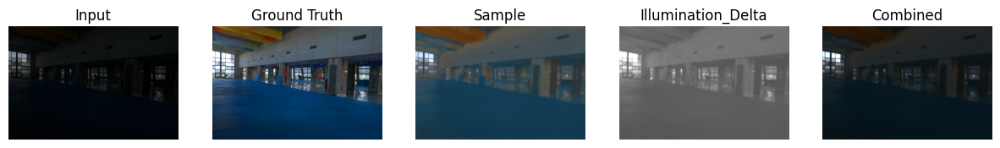

[*] Saving model RetinexNet-Relight
Relight Epoch: [ 3] [  15/  15] time: 0.3079, loss: 0.148465
[*] Evaluating for phase Relight / epoch 3...


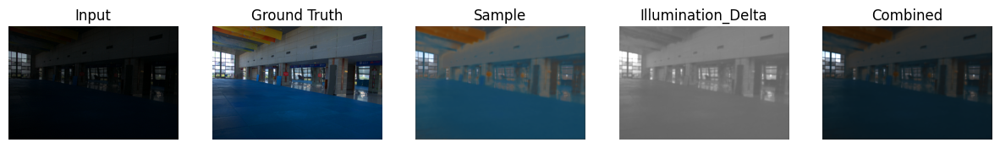

[*] Saving model RetinexNet-Relight
Relight Epoch: [ 4] [  15/  15] time: 0.3088, loss: 0.130796
[*] Evaluating for phase Relight / epoch 4...


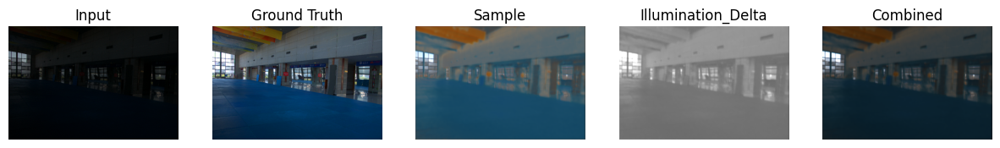

[*] Saving model RetinexNet-Relight
Relight Epoch: [ 5] [  15/  15] time: 0.3087, loss: 0.154280
[*] Evaluating for phase Relight / epoch 5...


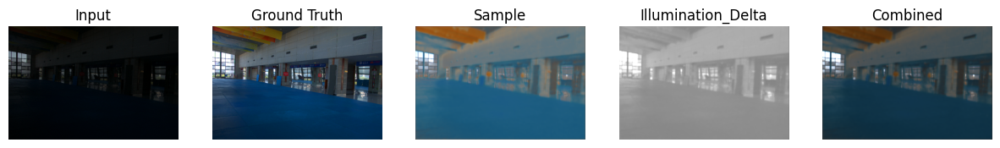

[*] Saving model RetinexNet-Relight
Relight Epoch: [ 6] [  15/  15] time: 0.3131, loss: 0.147435
[*] Evaluating for phase Relight / epoch 6...


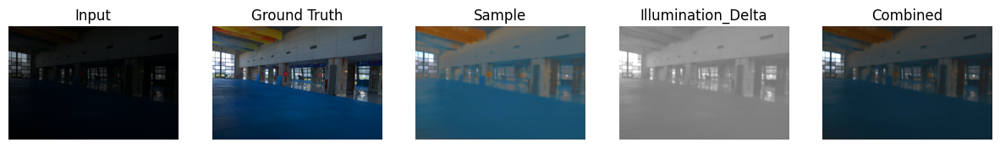

[*] Saving model RetinexNet-Relight
Relight Epoch: [ 7] [  15/  15] time: 0.3091, loss: 0.128823
[*] Evaluating for phase Relight / epoch 7...


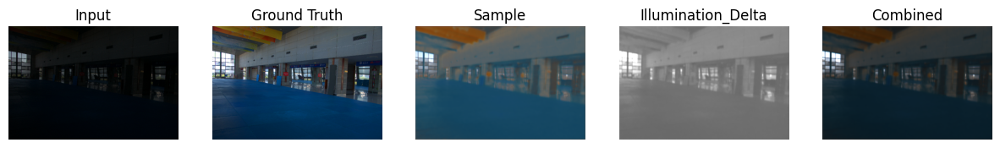

[*] Saving model RetinexNet-Relight
Relight Epoch: [ 8] [  15/  15] time: 0.3107, loss: 0.133957
[*] Evaluating for phase Relight / epoch 8...


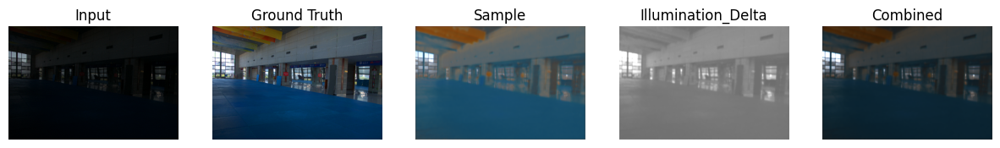

[*] Saving model RetinexNet-Relight
Relight Epoch: [ 9] [  15/  15] time: 0.3100, loss: 0.124226
[*] Evaluating for phase Relight / epoch 9...


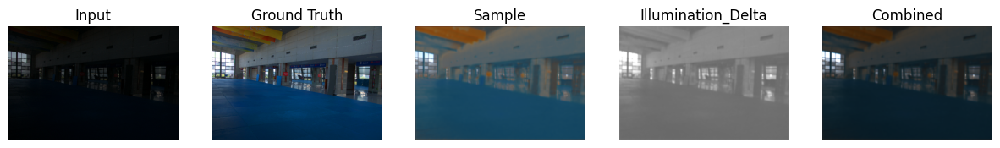

[*] Saving model RetinexNet-Relight
Relight Epoch: [10] [  15/  15] time: 0.3108, loss: 0.143695
[*] Evaluating for phase Relight / epoch 10...


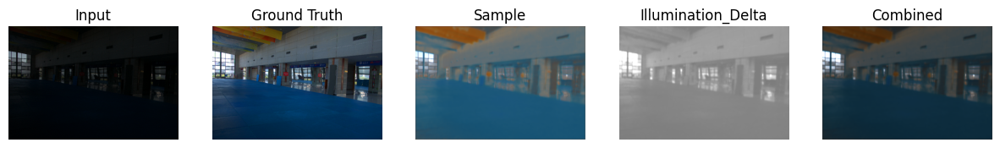

[*] Saving model RetinexNet-Relight
Relight Epoch: [11] [  15/  15] time: 0.3098, loss: 0.197922
[*] Evaluating for phase Relight / epoch 11...


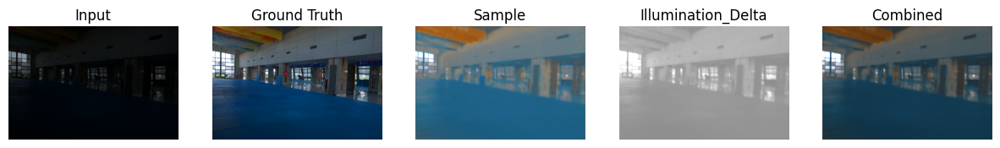

[*] Saving model RetinexNet-Relight
Relight Epoch: [12] [  15/  15] time: 0.3095, loss: 0.183054
[*] Evaluating for phase Relight / epoch 12...


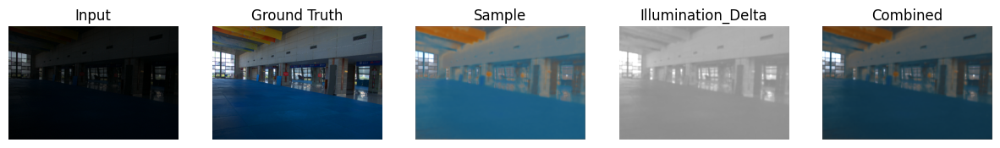

[*] Saving model RetinexNet-Relight
Relight Epoch: [13] [  15/  15] time: 0.3064, loss: 0.217820
[*] Evaluating for phase Relight / epoch 13...


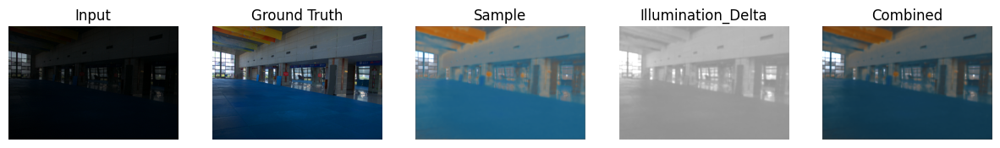

[*] Saving model RetinexNet-Relight
Relight Epoch: [14] [  15/  15] time: 0.3081, loss: 0.189061
[*] Evaluating for phase Relight / epoch 14...


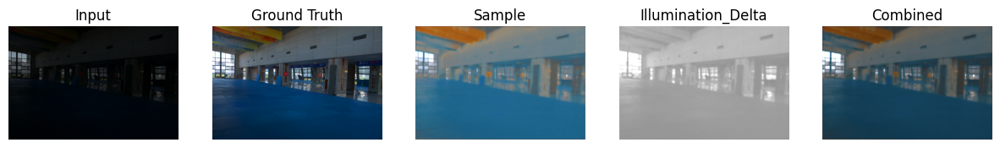

[*] Saving model RetinexNet-Relight
Relight Epoch: [15] [  15/  15] time: 0.3076, loss: 0.177792
[*] Evaluating for phase Relight / epoch 15...


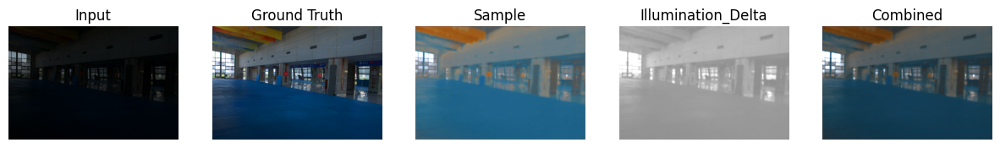

[*] Saving model RetinexNet-Relight
Relight Epoch: [16] [  15/  15] time: 0.3115, loss: 0.175246
[*] Evaluating for phase Relight / epoch 16...


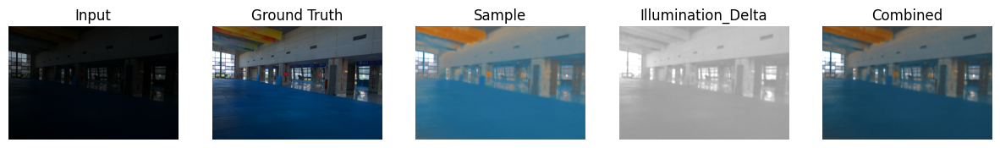

[*] Saving model RetinexNet-Relight
Relight Epoch: [17] [  15/  15] time: 0.3073, loss: 0.155955
[*] Evaluating for phase Relight / epoch 17...


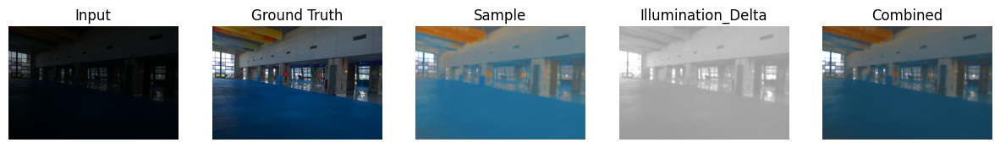

[*] Saving model RetinexNet-Relight
Relight Epoch: [18] [  15/  15] time: 0.3091, loss: 0.169810
[*] Evaluating for phase Relight / epoch 18...


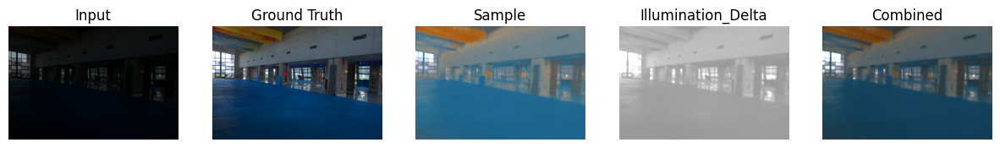

[*] Saving model RetinexNet-Relight
Relight Epoch: [19] [  15/  15] time: 0.3079, loss: 0.155237
[*] Evaluating for phase Relight / epoch 19...


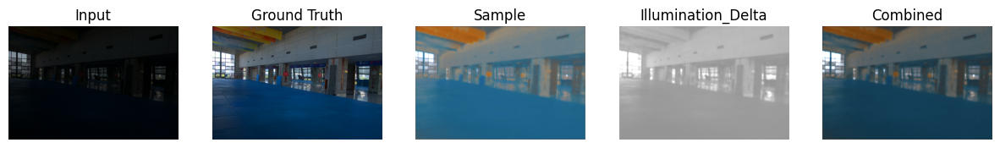

[*] Saving model RetinexNet-Relight
Relight Epoch: [20] [  15/  15] time: 0.3064, loss: 0.144903
[*] Evaluating for phase Relight / epoch 20...


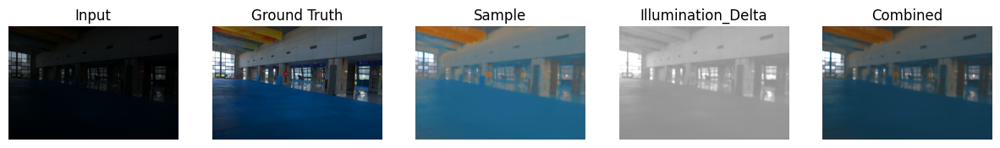

[*] Saving model RetinexNet-Relight
Relight Epoch: [21] [  15/  15] time: 0.3098, loss: 0.178523
[*] Evaluating for phase Relight / epoch 21...


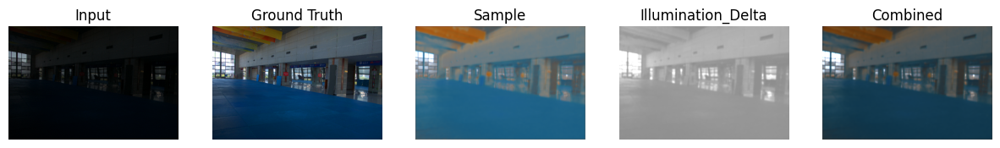

[*] Saving model RetinexNet-Relight
Relight Epoch: [22] [  15/  15] time: 0.3097, loss: 0.138927
[*] Evaluating for phase Relight / epoch 22...


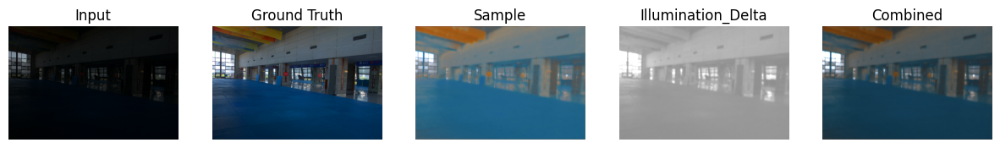

[*] Saving model RetinexNet-Relight
Relight Epoch: [23] [  15/  15] time: 0.3070, loss: 0.134263
[*] Evaluating for phase Relight / epoch 23...


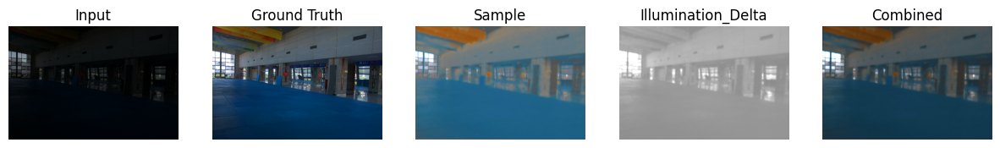

[*] Saving model RetinexNet-Relight
Relight Epoch: [24] [  15/  15] time: 0.3072, loss: 0.168137
[*] Evaluating for phase Relight / epoch 24...


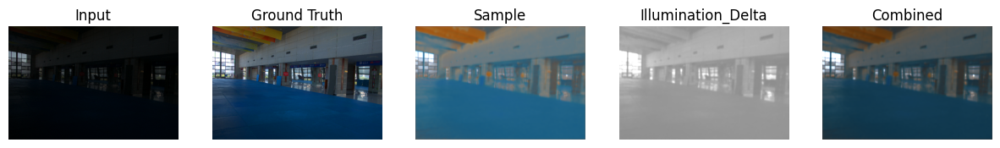

[*] Saving model RetinexNet-Relight
Relight Epoch: [25] [  15/  15] time: 0.3090, loss: 0.149079
[*] Evaluating for phase Relight / epoch 25...


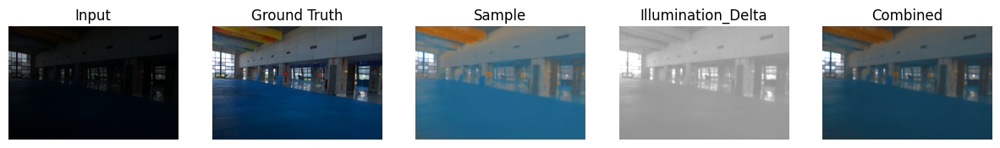

[*] Saving model RetinexNet-Relight
Relight Epoch: [26] [  15/  15] time: 0.3091, loss: 0.175060
[*] Evaluating for phase Relight / epoch 26...


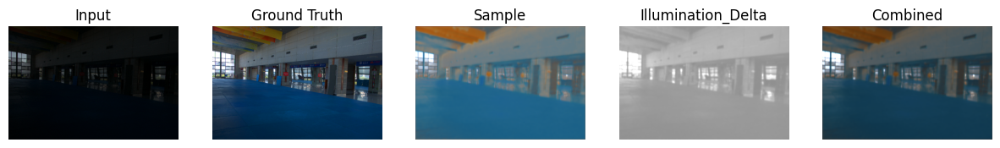

[*] Saving model RetinexNet-Relight
Relight Epoch: [27] [  15/  15] time: 0.3092, loss: 0.177944
[*] Evaluating for phase Relight / epoch 27...


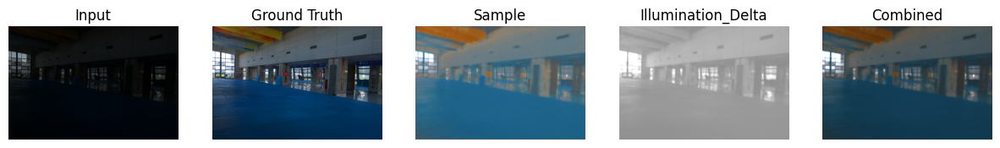

[*] Saving model RetinexNet-Relight
Relight Epoch: [28] [  15/  15] time: 0.3075, loss: 0.216100
[*] Evaluating for phase Relight / epoch 28...


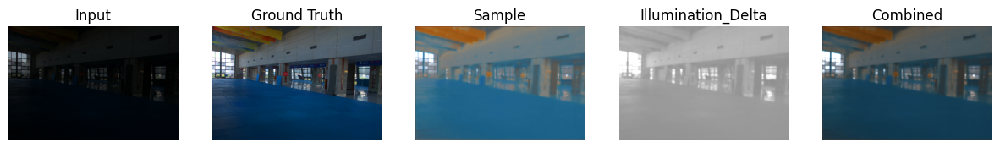

[*] Saving model RetinexNet-Relight
Relight Epoch: [29] [  15/  15] time: 0.3171, loss: 0.194928
[*] Evaluating for phase Relight / epoch 29...


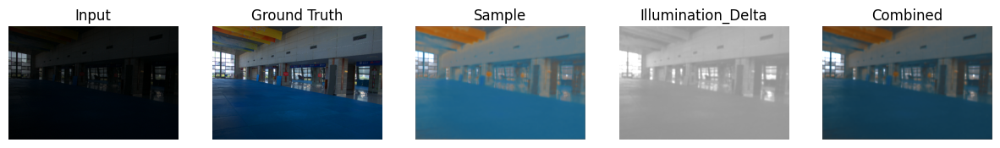

[*] Saving model RetinexNet-Relight
Relight Epoch: [30] [  15/  15] time: 0.3190, loss: 0.188328
[*] Evaluating for phase Relight / epoch 30...


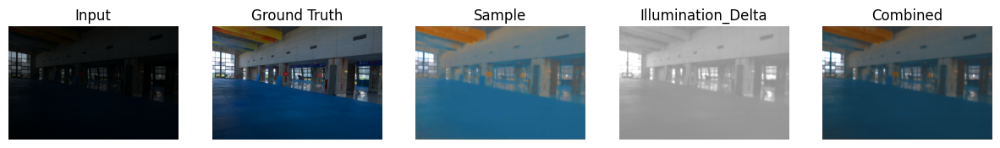

[*] Saving model RetinexNet-Relight
Relight Epoch: [31] [  15/  15] time: 0.3158, loss: 0.178244
[*] Evaluating for phase Relight / epoch 31...


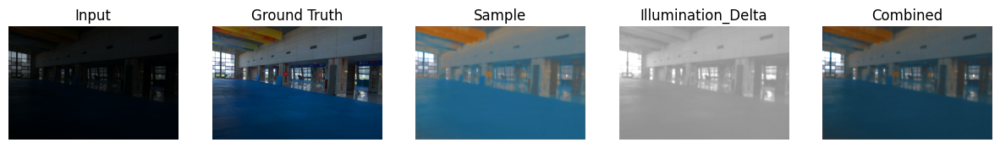

[*] Saving model RetinexNet-Relight
Relight Epoch: [32] [  15/  15] time: 0.3083, loss: 0.190987
[*] Evaluating for phase Relight / epoch 32...


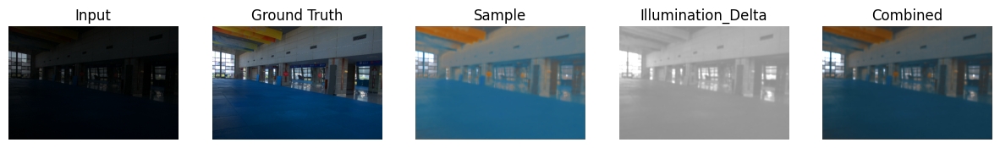

[*] Saving model RetinexNet-Relight
Relight Epoch: [33] [  15/  15] time: 0.3104, loss: 0.151173
[*] Evaluating for phase Relight / epoch 33...


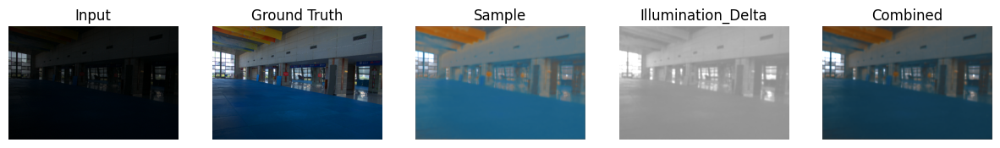

[*] Saving model RetinexNet-Relight
Relight Epoch: [34] [  15/  15] time: 0.3127, loss: 0.182551
[*] Evaluating for phase Relight / epoch 34...


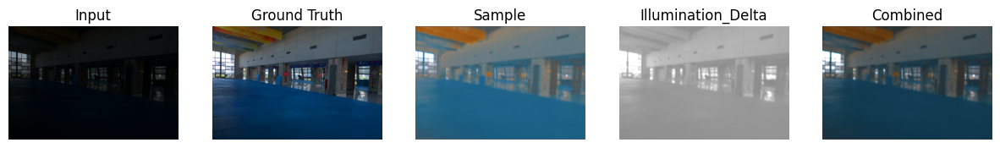

[*] Saving model RetinexNet-Relight
Relight Epoch: [35] [  15/  15] time: 0.3118, loss: 0.174512
[*] Evaluating for phase Relight / epoch 35...


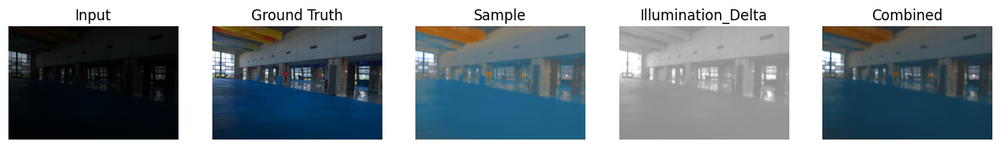

[*] Saving model RetinexNet-Relight
Relight Epoch: [36] [  15/  15] time: 0.3070, loss: 0.194217
[*] Evaluating for phase Relight / epoch 36...


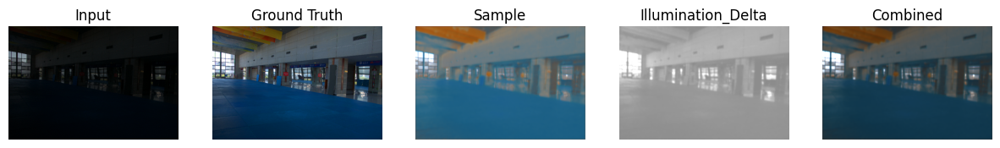

[*] Saving model RetinexNet-Relight
Relight Epoch: [37] [  15/  15] time: 0.3091, loss: 0.187087
[*] Evaluating for phase Relight / epoch 37...


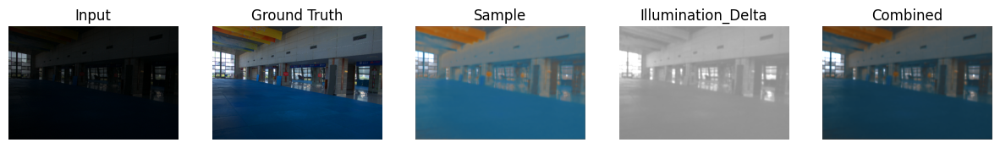

[*] Saving model RetinexNet-Relight
Relight Epoch: [38] [  15/  15] time: 0.3081, loss: 0.179291
[*] Evaluating for phase Relight / epoch 38...


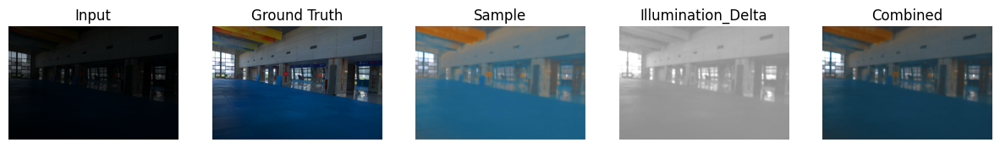

[*] Saving model RetinexNet-Relight
Relight Epoch: [39] [  15/  15] time: 0.3168, loss: 0.171773
[*] Evaluating for phase Relight / epoch 39...


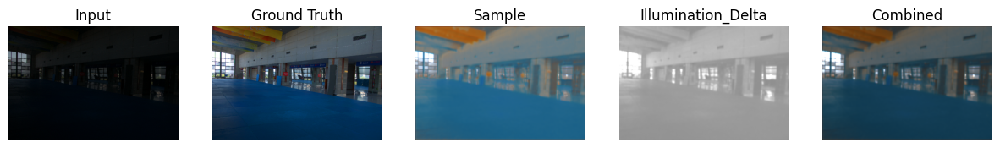

[*] Saving model RetinexNet-Relight
Relight Epoch: [40] [  15/  15] time: 0.3106, loss: 0.197209
[*] Evaluating for phase Relight / epoch 40...


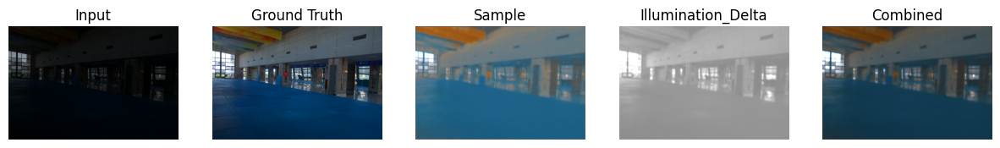

[*] Saving model RetinexNet-Relight
Relight Epoch: [41] [  15/  15] time: 0.3073, loss: 0.175553
[*] Evaluating for phase Relight / epoch 41...


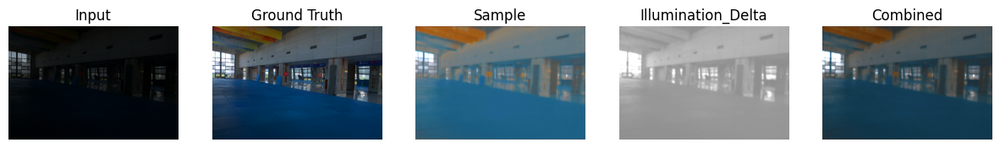

[*] Saving model RetinexNet-Relight
Relight Epoch: [42] [  15/  15] time: 0.3090, loss: 0.177070
[*] Evaluating for phase Relight / epoch 42...


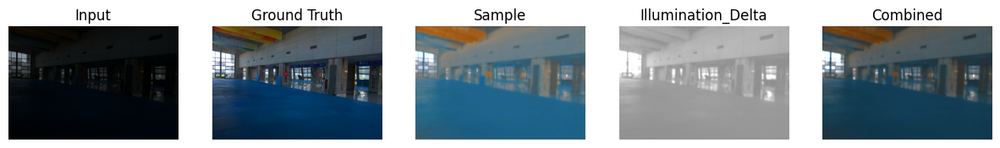

[*] Saving model RetinexNet-Relight
Relight Epoch: [43] [  15/  15] time: 0.3095, loss: 0.178093
[*] Evaluating for phase Relight / epoch 43...


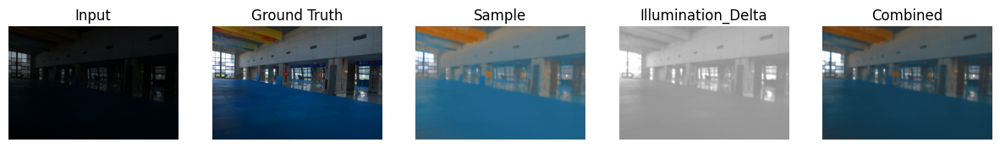

[*] Saving model RetinexNet-Relight
Relight Epoch: [44] [  15/  15] time: 0.3097, loss: 0.181890
[*] Evaluating for phase Relight / epoch 44...


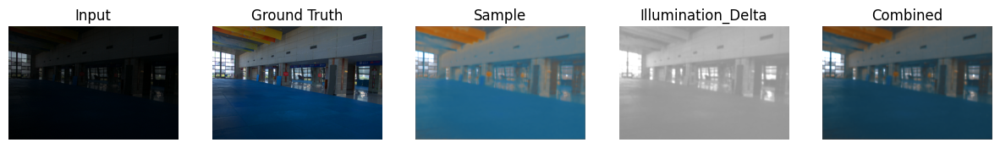

[*] Saving model RetinexNet-Relight
Relight Epoch: [45] [  15/  15] time: 0.3085, loss: 0.179431
[*] Evaluating for phase Relight / epoch 45...


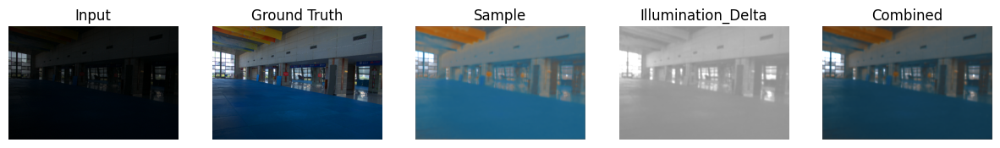

[*] Saving model RetinexNet-Relight
Relight Epoch: [46] [  15/  15] time: 0.3097, loss: 0.186087
[*] Evaluating for phase Relight / epoch 46...


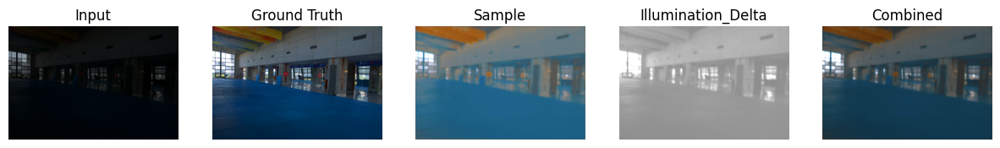

[*] Saving model RetinexNet-Relight
Relight Epoch: [47] [  15/  15] time: 0.3073, loss: 0.182948
[*] Evaluating for phase Relight / epoch 47...


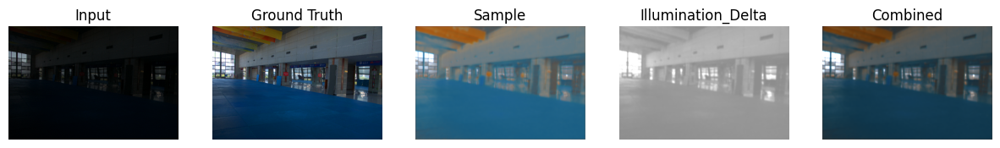

[*] Saving model RetinexNet-Relight
Relight Epoch: [48] [  15/  15] time: 0.3096, loss: 0.184003
[*] Evaluating for phase Relight / epoch 48...


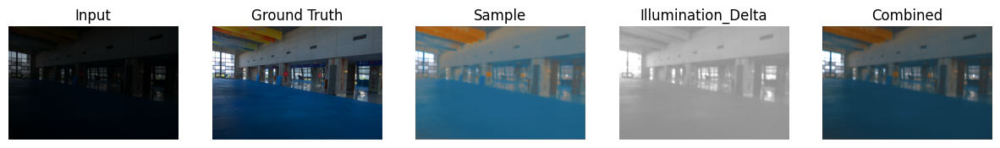

[*] Saving model RetinexNet-Relight
Relight Epoch: [49] [  15/  15] time: 0.3104, loss: 0.202674
[*] Evaluating for phase Relight / epoch 49...


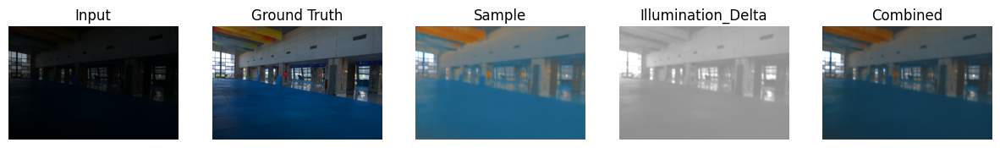

[*] Saving model RetinexNet-Relight
Relight Epoch: [50] [  15/  15] time: 0.3107, loss: 0.216528
[*] Evaluating for phase Relight / epoch 50...


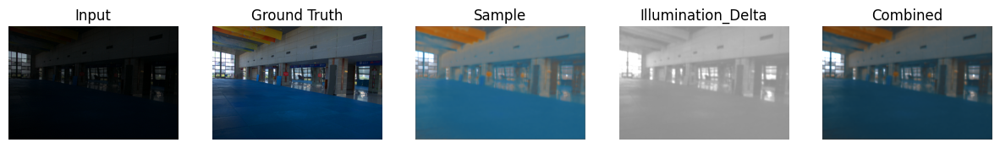

[*] Saving model RetinexNet-Relight
[*] Finish training for phase Relight in time 51.6476.


In [13]:
tf.reset_default_graph()

gpu_options = tf.GPUOptions(per_process_gpu_memory_fraction=1)
with tf.Session(config=tf.ConfigProto(gpu_options=gpu_options)) as sess:
    model = lowlight_enhance(sess)
    lowlight_train(model)

### Model Test

In [14]:
def lowlight_test(lowlight_enhance):
    if not os.path.exists(save_test_path):
        os.makedirs(save_test_path)

    test_low_data_name = glob(os.path.join(test_path) + '/low/*.*')
    test_high_data_name = glob(os.path.join(test_path) + '/high/*.*')
    test_low_data = []
    test_high_data = []
  
    for idx in range(len(test_low_data_name)):
        test_low_im = load_images(test_low_data_name[idx])
        test_low_data.append(test_low_im)
    
    for idx in range(len(test_high_data_name)):
        test_high_im = load_images(test_high_data_name[idx])
        test_high_data.append(test_high_im)

    lowlight_enhance.test(test_low_data, test_high_data, test_low_data_name, save_dir=save_test_path, decom_flag=decom)

/tmp/ipykernel_36/1021350135.py:5: UserWarning: `tf.layers.conv2d` is deprecated and will be removed in a future version. Please Use `tf.keras.layers.Conv2D` instead.
  conv = tf.layers.conv2d(input_im, channel, kernel_size * 3, padding='same', activation=None, name="shallow_feature_extraction")
/tmp/ipykernel_36/1021350135.py:7: UserWarning: `tf.layers.conv2d` is deprecated and will be removed in a future version. Please Use `tf.keras.layers.Conv2D` instead.
  conv = tf.layers.conv2d(conv, channel, kernel_size, padding='same', activation=tf.nn.relu, name=f'activated_layer_{idx}')
/tmp/ipykernel_36/1021350135.py:8: UserWarning: `tf.layers.conv2d` is deprecated and will be removed in a future version. Please Use `tf.keras.layers.Conv2D` instead.
  conv = tf.layers.conv2d(conv, 4, kernel_size, padding='same', activation=None, name='recon_layer')
/tmp/ipykernel_36/1021350135.py:18: UserWarning: `tf.layers.conv2d` is deprecated and will be removed in a future version. Please Use `tf.keras.

[*] Initialize model successfully...
[*] Reading checkpoint...
[*] Load weights successfully...
[*] Testing...
/kaggle/input/lol-dataset/lol_dataset/eval15/low/780.png
[*] Saved at /kaggle/working/Model/Model_Data/save/780_R_low.png
[*] Saved at /kaggle/working/Model/Model_Data/save/780_I_low.png
[*] Saved at /kaggle/working/Model/Model_Data/save/780_I_delta.png
[*] Saved at /kaggle/working/Model/Model_Data/save/780_S.png
[*] Saved at /kaggle/working/Model/Model_Data/save/780_Result.png


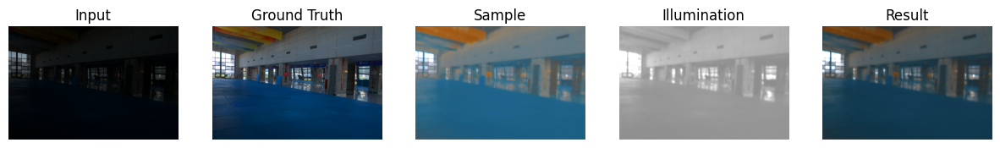

/kaggle/input/lol-dataset/lol_dataset/eval15/low/778.png
[*] Saved at /kaggle/working/Model/Model_Data/save/778_R_low.png
[*] Saved at /kaggle/working/Model/Model_Data/save/778_I_low.png
[*] Saved at /kaggle/working/Model/Model_Data/save/778_I_delta.png
[*] Saved at /kaggle/working/Model/Model_Data/save/778_S.png
[*] Saved at /kaggle/working/Model/Model_Data/save/778_Result.png


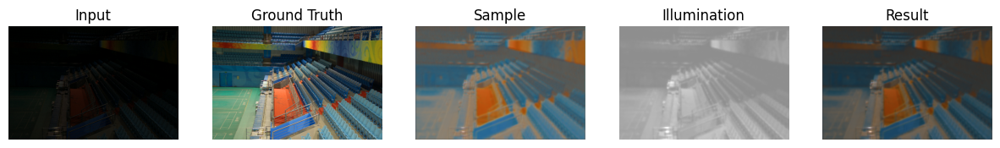

/kaggle/input/lol-dataset/lol_dataset/eval15/low/493.png
[*] Saved at /kaggle/working/Model/Model_Data/save/493_R_low.png
[*] Saved at /kaggle/working/Model/Model_Data/save/493_I_low.png
[*] Saved at /kaggle/working/Model/Model_Data/save/493_I_delta.png
[*] Saved at /kaggle/working/Model/Model_Data/save/493_S.png
[*] Saved at /kaggle/working/Model/Model_Data/save/493_Result.png


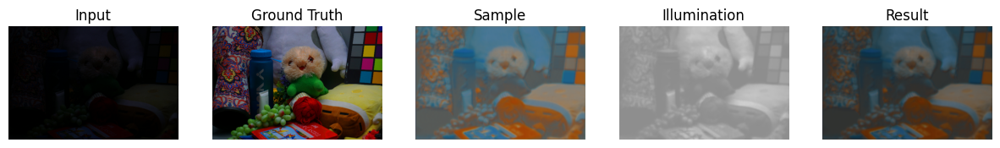

/kaggle/input/lol-dataset/lol_dataset/eval15/low/669.png
[*] Saved at /kaggle/working/Model/Model_Data/save/669_R_low.png
[*] Saved at /kaggle/working/Model/Model_Data/save/669_I_low.png
[*] Saved at /kaggle/working/Model/Model_Data/save/669_I_delta.png
[*] Saved at /kaggle/working/Model/Model_Data/save/669_S.png
[*] Saved at /kaggle/working/Model/Model_Data/save/669_Result.png


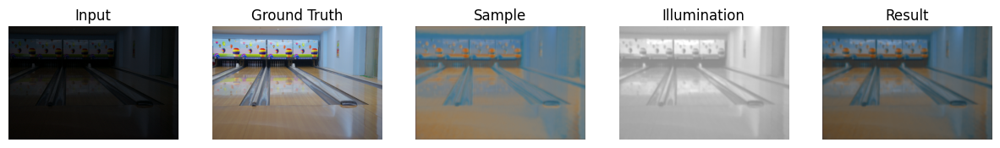

/kaggle/input/lol-dataset/lol_dataset/eval15/low/547.png
[*] Saved at /kaggle/working/Model/Model_Data/save/547_R_low.png
[*] Saved at /kaggle/working/Model/Model_Data/save/547_I_low.png
[*] Saved at /kaggle/working/Model/Model_Data/save/547_I_delta.png
[*] Saved at /kaggle/working/Model/Model_Data/save/547_S.png
[*] Saved at /kaggle/working/Model/Model_Data/save/547_Result.png


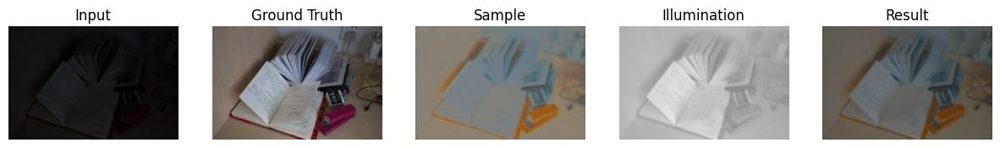

/kaggle/input/lol-dataset/lol_dataset/eval15/low/55.png
[*] Saved at /kaggle/working/Model/Model_Data/save/55_R_low.png
[*] Saved at /kaggle/working/Model/Model_Data/save/55_I_low.png
[*] Saved at /kaggle/working/Model/Model_Data/save/55_I_delta.png
[*] Saved at /kaggle/working/Model/Model_Data/save/55_S.png
[*] Saved at /kaggle/working/Model/Model_Data/save/55_Result.png


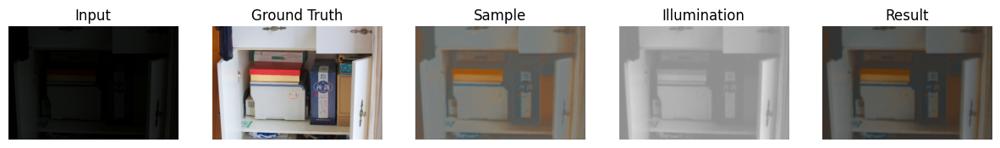

/kaggle/input/lol-dataset/lol_dataset/eval15/low/1.png
[*] Saved at /kaggle/working/Model/Model_Data/save/1_R_low.png
[*] Saved at /kaggle/working/Model/Model_Data/save/1_I_low.png
[*] Saved at /kaggle/working/Model/Model_Data/save/1_I_delta.png
[*] Saved at /kaggle/working/Model/Model_Data/save/1_S.png
[*] Saved at /kaggle/working/Model/Model_Data/save/1_Result.png


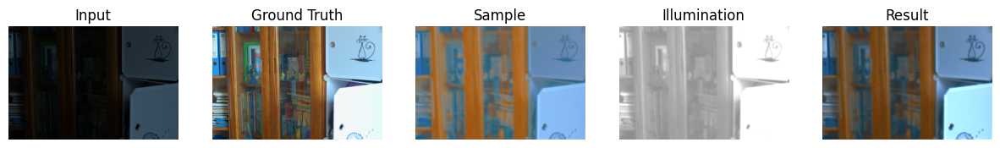

/kaggle/input/lol-dataset/lol_dataset/eval15/low/748.png
[*] Saved at /kaggle/working/Model/Model_Data/save/748_R_low.png
[*] Saved at /kaggle/working/Model/Model_Data/save/748_I_low.png
[*] Saved at /kaggle/working/Model/Model_Data/save/748_I_delta.png
[*] Saved at /kaggle/working/Model/Model_Data/save/748_S.png
[*] Saved at /kaggle/working/Model/Model_Data/save/748_Result.png


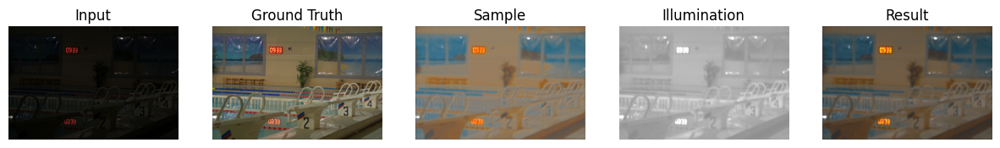

/kaggle/input/lol-dataset/lol_dataset/eval15/low/22.png
[*] Saved at /kaggle/working/Model/Model_Data/save/22_R_low.png
[*] Saved at /kaggle/working/Model/Model_Data/save/22_I_low.png
[*] Saved at /kaggle/working/Model/Model_Data/save/22_I_delta.png
[*] Saved at /kaggle/working/Model/Model_Data/save/22_S.png
[*] Saved at /kaggle/working/Model/Model_Data/save/22_Result.png


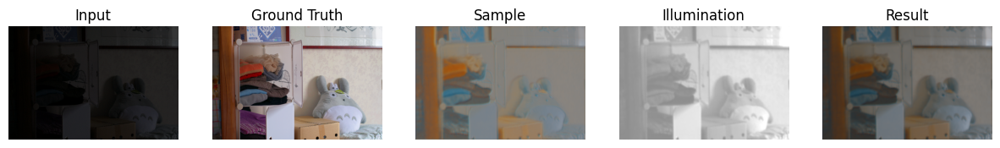

/kaggle/input/lol-dataset/lol_dataset/eval15/low/146.png
[*] Saved at /kaggle/working/Model/Model_Data/save/146_R_low.png
[*] Saved at /kaggle/working/Model/Model_Data/save/146_I_low.png
[*] Saved at /kaggle/working/Model/Model_Data/save/146_I_delta.png
[*] Saved at /kaggle/working/Model/Model_Data/save/146_S.png
[*] Saved at /kaggle/working/Model/Model_Data/save/146_Result.png


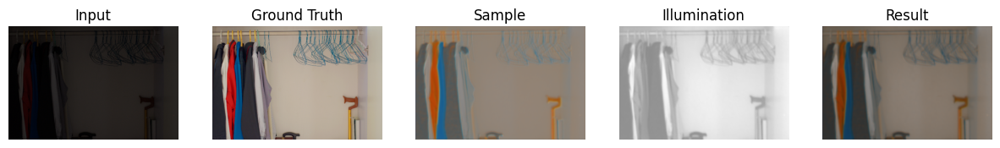

/kaggle/input/lol-dataset/lol_dataset/eval15/low/179.png
[*] Saved at /kaggle/working/Model/Model_Data/save/179_R_low.png
[*] Saved at /kaggle/working/Model/Model_Data/save/179_I_low.png
[*] Saved at /kaggle/working/Model/Model_Data/save/179_I_delta.png
[*] Saved at /kaggle/working/Model/Model_Data/save/179_S.png
[*] Saved at /kaggle/working/Model/Model_Data/save/179_Result.png


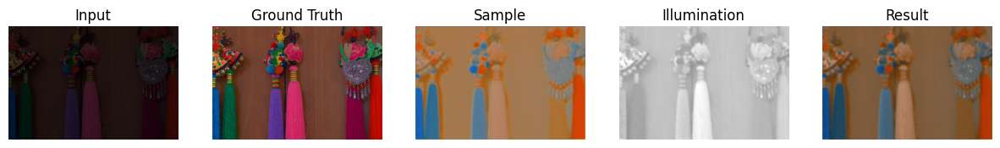

/kaggle/input/lol-dataset/lol_dataset/eval15/low/665.png
[*] Saved at /kaggle/working/Model/Model_Data/save/665_R_low.png
[*] Saved at /kaggle/working/Model/Model_Data/save/665_I_low.png
[*] Saved at /kaggle/working/Model/Model_Data/save/665_I_delta.png
[*] Saved at /kaggle/working/Model/Model_Data/save/665_S.png
[*] Saved at /kaggle/working/Model/Model_Data/save/665_Result.png


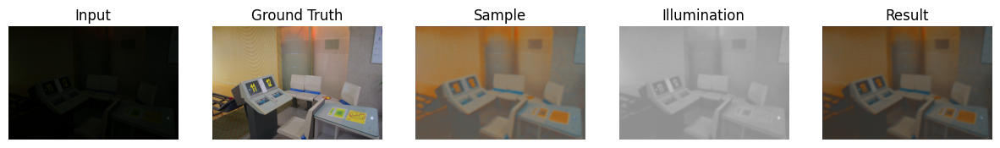

/kaggle/input/lol-dataset/lol_dataset/eval15/low/23.png
[*] Saved at /kaggle/working/Model/Model_Data/save/23_R_low.png
[*] Saved at /kaggle/working/Model/Model_Data/save/23_I_low.png
[*] Saved at /kaggle/working/Model/Model_Data/save/23_I_delta.png
[*] Saved at /kaggle/working/Model/Model_Data/save/23_S.png
[*] Saved at /kaggle/working/Model/Model_Data/save/23_Result.png


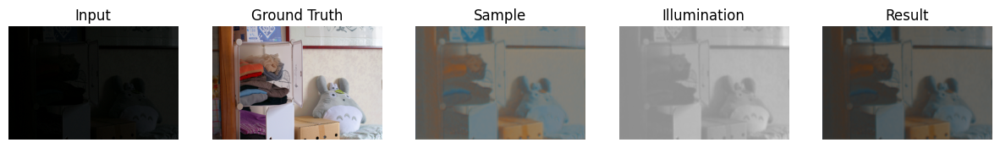

/kaggle/input/lol-dataset/lol_dataset/eval15/low/111.png
[*] Saved at /kaggle/working/Model/Model_Data/save/111_R_low.png
[*] Saved at /kaggle/working/Model/Model_Data/save/111_I_low.png
[*] Saved at /kaggle/working/Model/Model_Data/save/111_I_delta.png
[*] Saved at /kaggle/working/Model/Model_Data/save/111_S.png
[*] Saved at /kaggle/working/Model/Model_Data/save/111_Result.png


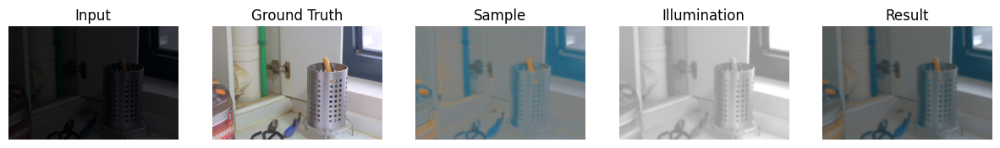

/kaggle/input/lol-dataset/lol_dataset/eval15/low/79.png
[*] Saved at /kaggle/working/Model/Model_Data/save/79_R_low.png
[*] Saved at /kaggle/working/Model/Model_Data/save/79_I_low.png
[*] Saved at /kaggle/working/Model/Model_Data/save/79_I_delta.png
[*] Saved at /kaggle/working/Model/Model_Data/save/79_S.png
[*] Saved at /kaggle/working/Model/Model_Data/save/79_Result.png


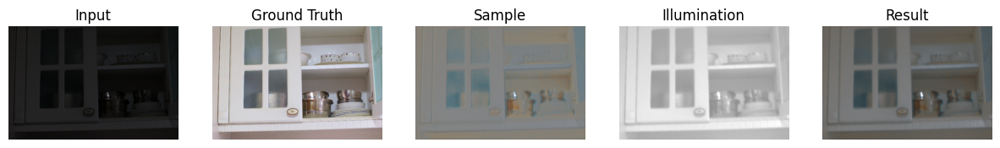

In [15]:
tf.reset_default_graph()

gpu_options = tf.GPUOptions(per_process_gpu_memory_fraction=1)
with tf.Session(config=tf.ConfigProto(gpu_options=gpu_options)) as sess:
    model = lowlight_enhance(sess)
    lowlight_test(model)